# Afriat

In [1]:
scan=0.20

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: fzbmqo7q
Name: old-republic-149
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/fzbmqo7q
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_135919-fzbmqo7q/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2565,3315,9363
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2565,2595,1697,3414,1632,3340
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4485,10758
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 640,794,2376
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 640,607,411,876,417,859
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1099,2711
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:18<3:01:11, 18.15s/it]

Epoch 1/600:   0%|          | 1/600 [00:18<3:01:11, 18.15s/it, v_num=7q_1, total_loss_train=3.68e+3, kl_local_train=59.9]

Epoch 2/600:   0%|          | 1/600 [00:18<3:01:11, 18.15s/it, v_num=7q_1, total_loss_train=3.68e+3, kl_local_train=59.9]

Epoch 2/600:   0%|          | 2/600 [00:33<2:43:23, 16.39s/it, v_num=7q_1, total_loss_train=3.68e+3, kl_local_train=59.9]

Epoch 2/600:   0%|          | 2/600 [00:33<2:43:23, 16.39s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=91.7]

Epoch 3/600:   0%|          | 2/600 [00:33<2:43:23, 16.39s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=91.7]

Epoch 3/600:   0%|          | 3/600 [00:48<2:35:21, 15.61s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=91.7]

Epoch 3/600:   0%|          | 3/600 [00:48<2:35:21, 15.61s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=93]  

Epoch 4/600:   0%|          | 3/600 [00:48<2:35:21, 15.61s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=93]

Epoch 4/600:   1%|          | 4/600 [01:04<2:37:21, 15.84s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=93]

Epoch 4/600:   1%|          | 4/600 [01:04<2:37:21, 15.84s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=88]

Epoch 5/600:   1%|          | 4/600 [01:04<2:37:21, 15.84s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=88]

Epoch 5/600:   1%|          | 5/600 [01:21<2:41:33, 16.29s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=88]

Epoch 5/600:   1%|          | 5/600 [01:21<2:41:33, 16.29s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=78.9]

Epoch 6/600:   1%|          | 5/600 [01:22<2:41:33, 16.29s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=78.9]

Epoch 6/600:   1%|          | 6/600 [01:39<2:48:36, 17.03s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=78.9]

Epoch 6/600:   1%|          | 6/600 [01:39<2:48:36, 17.03s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 7/600:   1%|          | 6/600 [01:39<2:48:36, 17.03s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 7/600:   1%|          | 7/600 [01:56<2:46:15, 16.82s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 7/600:   1%|          | 7/600 [01:56<2:46:15, 16.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346] 

Epoch 8/600:   1%|          | 7/600 [01:56<2:46:15, 16.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 8/600:   1%|▏         | 8/600 [02:11<2:42:27, 16.47s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 8/600:   1%|▏         | 8/600 [02:11<2:42:27, 16.47s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 9/600:   1%|▏         | 8/600 [02:11<2:42:27, 16.47s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 9/600:   2%|▏         | 9/600 [02:27<2:39:53, 16.23s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 9/600:   2%|▏         | 9/600 [02:27<2:39:53, 16.23s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]  

Epoch 10/600:   2%|▏         | 9/600 [02:27<2:39:53, 16.23s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 10/600:   2%|▏         | 10/600 [02:43<2:38:55, 16.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=24, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 10/600:   2%|▏         | 10/600 [02:43<2:38:55, 16.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=23.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 11/600:   2%|▏         | 10/600 [02:45<2:38:55, 16.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=23.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 11/600:   2%|▏         | 11/600 [02:58<2:35:34, 15.85s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=23.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.007, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0346]

Epoch 11/600:   2%|▏         | 11/600 [02:58<2:35:34, 15.85s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 12/600:   2%|▏         | 11/600 [02:58<2:35:34, 15.85s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 12/600:   2%|▏         | 12/600 [03:12<2:28:43, 15.18s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 12/600:   2%|▏         | 12/600 [03:12<2:28:43, 15.18s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=39, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413] 

Epoch 13/600:   2%|▏         | 12/600 [03:12<2:28:43, 15.18s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=39, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 13/600:   2%|▏         | 13/600 [03:25<2:23:49, 14.70s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=39, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 13/600:   2%|▏         | 13/600 [03:25<2:23:49, 14.70s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 14/600:   2%|▏         | 13/600 [03:25<2:23:49, 14.70s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 14/600:   2%|▏         | 14/600 [03:39<2:20:11, 14.35s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 14/600:   2%|▏         | 14/600 [03:39<2:20:11, 14.35s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 15/600:   2%|▏         | 14/600 [03:39<2:20:11, 14.35s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 15/600:   2%|▎         | 15/600 [03:53<2:18:24, 14.20s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 15/600:   2%|▎         | 15/600 [03:53<2:18:24, 14.20s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 16/600:   2%|▎         | 15/600 [03:54<2:18:24, 14.20s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 16/600:   3%|▎         | 16/600 [04:08<2:20:52, 14.47s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0172, metric_mi|mouse_train=0.0413]

Epoch 16/600:   3%|▎         | 16/600 [04:08<2:20:52, 14.47s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=62, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]  

Epoch 17/600:   3%|▎         | 16/600 [04:08<2:20:52, 14.47s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=62, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 17/600:   3%|▎         | 17/600 [04:22<2:18:09, 14.22s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=62, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 17/600:   3%|▎         | 17/600 [04:22<2:18:09, 14.22s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=71, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 18/600:   3%|▎         | 17/600 [04:22<2:18:09, 14.22s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=71, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 18/600:   3%|▎         | 18/600 [04:35<2:15:56, 14.01s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=71, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 18/600:   3%|▎         | 18/600 [04:35<2:15:56, 14.01s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 19/600:   3%|▎         | 18/600 [04:35<2:15:56, 14.01s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 19/600:   3%|▎         | 19/600 [04:49<2:14:43, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 19/600:   3%|▎         | 19/600 [04:49<2:14:43, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 20/600:   3%|▎         | 19/600 [04:49<2:14:43, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 20/600:   3%|▎         | 20/600 [05:03<2:14:25, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 20/600:   3%|▎         | 20/600 [05:03<2:14:25, 13.91s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 21/600:   3%|▎         | 20/600 [05:04<2:14:25, 13.91s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 21/600:   4%|▎         | 21/600 [05:18<2:18:37, 14.37s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0774, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0524]

Epoch 21/600:   4%|▎         | 21/600 [05:18<2:18:37, 14.37s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782] 

Epoch 22/600:   4%|▎         | 21/600 [05:18<2:18:37, 14.37s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 22/600:   4%|▎         | 22/600 [05:32<2:16:25, 14.16s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 22/600:   4%|▎         | 22/600 [05:32<2:16:25, 14.16s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 23/600:   4%|▎         | 22/600 [05:32<2:16:25, 14.16s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 23/600:   4%|▍         | 23/600 [05:45<2:14:43, 14.01s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 23/600:   4%|▍         | 23/600 [05:45<2:14:43, 14.01s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 24/600:   4%|▍         | 23/600 [05:45<2:14:43, 14.01s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 24/600:   4%|▍         | 24/600 [05:59<2:13:23, 13.90s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 24/600:   4%|▍         | 24/600 [05:59<2:13:23, 13.90s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 25/600:   4%|▍         | 24/600 [05:59<2:13:23, 13.90s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 25/600:   4%|▍         | 25/600 [06:13<2:13:07, 13.89s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 25/600:   4%|▍         | 25/600 [06:13<2:13:07, 13.89s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 26/600:   4%|▍         | 25/600 [06:15<2:13:07, 13.89s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 26/600:   4%|▍         | 26/600 [06:28<2:16:51, 14.31s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0601, metric_mi|mouse_train=0.0782]

Epoch 26/600:   4%|▍         | 26/600 [06:28<2:16:51, 14.31s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994] 

Epoch 27/600:   4%|▍         | 26/600 [06:28<2:16:51, 14.31s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 27/600:   4%|▍         | 27/600 [06:42<2:14:32, 14.09s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=125, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 27/600:   4%|▍         | 27/600 [06:42<2:14:32, 14.09s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 28/600:   4%|▍         | 27/600 [06:42<2:14:32, 14.09s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 28/600:   5%|▍         | 28/600 [06:55<2:12:38, 13.91s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 28/600:   5%|▍         | 28/600 [06:55<2:12:38, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 29/600:   5%|▍         | 28/600 [06:55<2:12:38, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 29/600:   5%|▍         | 29/600 [07:09<2:11:28, 13.82s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 29/600:   5%|▍         | 29/600 [07:09<2:11:28, 13.82s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 30/600:   5%|▍         | 29/600 [07:09<2:11:28, 13.82s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 30/600:   5%|▌         | 30/600 [07:23<2:10:55, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 30/600:   5%|▌         | 30/600 [07:23<2:10:55, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 31/600:   5%|▌         | 30/600 [07:24<2:10:55, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 31/600:   5%|▌         | 31/600 [07:38<2:14:47, 14.21s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0733, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0889, metric_mi|mouse_train=0.0994]

Epoch 31/600:   5%|▌         | 31/600 [07:38<2:14:47, 14.21s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]   

Epoch 32/600:   5%|▌         | 31/600 [07:38<2:14:47, 14.21s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [07:51<2:12:54, 14.04s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [07:51<2:12:54, 14.04s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 33/600:   5%|▌         | 32/600 [07:51<2:12:54, 14.04s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [08:05<2:11:24, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [08:05<2:11:24, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 33/600 [08:05<2:11:24, 13.91s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [08:19<2:10:19, 13.81s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [08:19<2:10:19, 13.81s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 34/600 [08:19<2:10:19, 13.81s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [08:32<2:09:44, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [08:32<2:09:44, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 35/600 [08:34<2:09:44, 13.78s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [08:47<2:13:14, 14.17s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [08:47<2:13:14, 14.17s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|▌         | 36/600 [08:47<2:13:14, 14.17s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|▌         | 37/600 [09:01<2:11:44, 14.04s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 37/600:   6%|▌         | 37/600 [09:01<2:11:44, 14.04s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125] 

Epoch 38/600:   6%|▌         | 37/600 [09:01<2:11:44, 14.04s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 38/600:   6%|▋         | 38/600 [09:15<2:10:16, 13.91s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 38/600:   6%|▋         | 38/600 [09:15<2:10:16, 13.91s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|▋         | 38/600 [09:15<2:10:16, 13.91s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|▋         | 39/600 [09:28<2:09:11, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 39/600:   6%|▋         | 39/600 [09:28<2:09:11, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 40/600:   6%|▋         | 39/600 [09:28<2:09:11, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 40/600:   7%|▋         | 40/600 [09:42<2:08:10, 13.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 40/600:   7%|▋         | 40/600 [09:42<2:08:10, 13.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|▋         | 40/600 [09:43<2:08:10, 13.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|▋         | 41/600 [09:57<2:11:47, 14.15s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 41/600:   7%|▋         | 41/600 [09:57<2:11:47, 14.15s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|▋         | 41/600 [09:57<2:11:47, 14.15s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|▋         | 42/600 [10:10<2:08:28, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 42/600:   7%|▋         | 42/600 [10:10<2:08:28, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|▋         | 42/600 [10:10<2:08:28, 13.82s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|▋         | 43/600 [10:23<2:05:59, 13.57s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 43/600:   7%|▋         | 43/600 [10:23<2:05:59, 13.57s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|▋         | 43/600 [10:23<2:05:59, 13.57s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|▋         | 44/600 [10:36<2:03:37, 13.34s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 44/600:   7%|▋         | 44/600 [10:36<2:03:37, 13.34s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 45/600:   7%|▋         | 44/600 [10:36<2:03:37, 13.34s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 45/600:   8%|▊         | 45/600 [10:49<2:03:27, 13.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 45/600:   8%|▊         | 45/600 [10:49<2:03:27, 13.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|▊         | 45/600 [10:51<2:03:27, 13.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|▊         | 46/600 [11:06<2:12:06, 14.31s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 46/600:   8%|▊         | 46/600 [11:06<2:12:06, 14.31s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13] 

Epoch 47/600:   8%|▊         | 46/600 [11:06<2:12:06, 14.31s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [11:21<2:13:55, 14.53s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [11:21<2:13:55, 14.53s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 47/600 [11:21<2:13:55, 14.53s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [11:35<2:12:12, 14.37s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [11:35<2:12:12, 14.37s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 48/600 [11:35<2:12:12, 14.37s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [11:49<2:10:08, 14.17s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [11:49<2:10:08, 14.17s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 49/600 [11:49<2:10:08, 14.17s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [12:03<2:10:00, 14.18s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [12:03<2:10:00, 14.18s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 50/600 [12:04<2:10:00, 14.18s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [12:18<2:11:43, 14.40s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [12:18<2:11:43, 14.40s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 52/600:   8%|▊         | 51/600 [12:18<2:11:43, 14.40s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 52/600:   9%|▊         | 52/600 [12:32<2:10:49, 14.32s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=106, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 52/600:   9%|▊         | 52/600 [12:32<2:10:49, 14.32s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 53/600:   9%|▊         | 52/600 [12:32<2:10:49, 14.32s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 53/600:   9%|▉         | 53/600 [12:47<2:11:54, 14.47s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=105, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 53/600:   9%|▉         | 53/600 [12:47<2:11:54, 14.47s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 54/600:   9%|▉         | 53/600 [12:47<2:11:54, 14.47s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 54/600:   9%|▉         | 54/600 [13:02<2:13:47, 14.70s/it, v_num=7q_1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 54/600:   9%|▉         | 54/600 [13:02<2:13:47, 14.70s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 55/600:   9%|▉         | 54/600 [13:02<2:13:47, 14.70s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 55/600:   9%|▉         | 55/600 [13:17<2:15:01, 14.87s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 55/600:   9%|▉         | 55/600 [13:17<2:15:01, 14.87s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 56/600:   9%|▉         | 55/600 [13:19<2:15:01, 14.87s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 56/600:   9%|▉         | 56/600 [13:34<2:19:11, 15.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.131]

Epoch 56/600:   9%|▉         | 56/600 [13:34<2:19:11, 15.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 57/600:   9%|▉         | 56/600 [13:34<2:19:11, 15.35s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 57/600:  10%|▉         | 57/600 [13:48<2:17:12, 15.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 57/600:  10%|▉         | 57/600 [13:48<2:17:12, 15.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 57/600 [13:48<2:17:12, 15.16s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 58/600 [14:03<2:15:41, 15.02s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=99.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 58/600:  10%|▉         | 58/600 [14:03<2:15:41, 15.02s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 59/600:  10%|▉         | 58/600 [14:03<2:15:41, 15.02s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 59/600:  10%|▉         | 59/600 [14:17<2:13:44, 14.83s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=98.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 59/600:  10%|▉         | 59/600 [14:17<2:13:44, 14.83s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|▉         | 59/600 [14:17<2:13:44, 14.83s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|█         | 60/600 [14:32<2:13:15, 14.81s/it, v_num=7q_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 60/600:  10%|█         | 60/600 [14:32<2:13:15, 14.81s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132] 

Epoch 61/600:  10%|█         | 60/600 [14:34<2:13:15, 14.81s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 61/600:  10%|█         | 61/600 [14:48<2:14:32, 14.98s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.132]

Epoch 61/600:  10%|█         | 61/600 [14:48<2:14:32, 14.98s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 62/600:  10%|█         | 61/600 [14:48<2:14:32, 14.98s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 62/600:  10%|█         | 62/600 [15:02<2:13:14, 14.86s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 62/600:  10%|█         | 62/600 [15:02<2:13:14, 14.86s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 63/600:  10%|█         | 62/600 [15:02<2:13:14, 14.86s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 63/600:  10%|█         | 63/600 [15:17<2:11:50, 14.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 63/600:  10%|█         | 63/600 [15:17<2:11:50, 14.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 64/600:  10%|█         | 63/600 [15:17<2:11:50, 14.73s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 64/600:  11%|█         | 64/600 [15:31<2:10:19, 14.59s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 64/600:  11%|█         | 64/600 [15:31<2:10:19, 14.59s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 65/600:  11%|█         | 64/600 [15:31<2:10:19, 14.59s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 65/600:  11%|█         | 65/600 [15:45<2:09:34, 14.53s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 65/600:  11%|█         | 65/600 [15:45<2:09:34, 14.53s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 66/600:  11%|█         | 65/600 [15:47<2:09:34, 14.53s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 66/600:  11%|█         | 66/600 [16:00<2:11:12, 14.74s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 66/600:  11%|█         | 66/600 [16:00<2:11:12, 14.74s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|█         | 66/600 [16:00<2:11:12, 14.74s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|█         | 67/600 [16:15<2:09:31, 14.58s/it, v_num=7q_1, total_loss_train=3.2e+3, kl_local_train=92.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|█         | 67/600 [16:15<2:09:31, 14.58s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|█         | 67/600 [16:15<2:09:31, 14.58s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|█▏        | 68/600 [16:29<2:07:54, 14.43s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|█▏        | 68/600 [16:29<2:07:54, 14.43s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 69/600:  11%|█▏        | 68/600 [16:29<2:07:54, 14.43s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 69/600:  12%|█▏        | 69/600 [16:43<2:07:12, 14.37s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 69/600:  12%|█▏        | 69/600 [16:43<2:07:12, 14.37s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|█▏        | 69/600 [16:43<2:07:12, 14.37s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|█▏        | 70/600 [16:57<2:06:29, 14.32s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|█▏        | 70/600 [16:57<2:06:29, 14.32s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|█▏        | 70/600 [16:59<2:06:29, 14.32s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|█▏        | 71/600 [17:13<2:10:04, 14.75s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|█▏        | 71/600 [17:13<2:10:04, 14.75s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13] 

Epoch 72/600:  12%|█▏        | 71/600 [17:13<2:10:04, 14.75s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 72/600:  12%|█▏        | 72/600 [17:27<2:06:51, 14.42s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 72/600:  12%|█▏        | 72/600 [17:27<2:06:51, 14.42s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|█▏        | 72/600 [17:27<2:06:51, 14.42s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|█▏        | 73/600 [17:41<2:05:40, 14.31s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=89.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|█▏        | 73/600 [17:41<2:05:40, 14.31s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|█▏        | 73/600 [17:41<2:05:40, 14.31s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|█▏        | 74/600 [17:55<2:05:20, 14.30s/it, v_num=7q_1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|█▏        | 74/600 [17:55<2:05:20, 14.30s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|█▏        | 74/600 [17:55<2:05:20, 14.30s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|█▎        | 75/600 [18:09<2:05:21, 14.33s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=88.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|█▎        | 75/600 [18:09<2:05:21, 14.33s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 76/600:  12%|█▎        | 75/600 [18:11<2:05:21, 14.33s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 76/600:  13%|█▎        | 76/600 [18:25<2:07:35, 14.61s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.13]

Epoch 76/600:  13%|█▎        | 76/600 [18:25<2:07:35, 14.61s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132] 

Epoch 77/600:  13%|█▎        | 76/600 [18:25<2:07:35, 14.61s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 77/600:  13%|█▎        | 77/600 [18:39<2:05:57, 14.45s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 77/600:  13%|█▎        | 77/600 [18:39<2:05:57, 14.45s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 78/600:  13%|█▎        | 77/600 [18:39<2:05:57, 14.45s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 78/600:  13%|█▎        | 78/600 [18:53<2:04:34, 14.32s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 78/600:  13%|█▎        | 78/600 [18:53<2:04:34, 14.32s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 79/600:  13%|█▎        | 78/600 [18:53<2:04:34, 14.32s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 79/600:  13%|█▎        | 79/600 [19:07<2:03:42, 14.25s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 79/600:  13%|█▎        | 79/600 [19:07<2:03:42, 14.25s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 80/600:  13%|█▎        | 79/600 [19:07<2:03:42, 14.25s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 80/600:  13%|█▎        | 80/600 [19:21<2:02:38, 14.15s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 80/600:  13%|█▎        | 80/600 [19:21<2:02:38, 14.15s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 81/600:  13%|█▎        | 80/600 [19:22<2:02:38, 14.15s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 81/600:  14%|█▎        | 81/600 [19:36<2:05:53, 14.55s/it, v_num=7q_1, total_loss_train=3.18e+3, kl_local_train=85.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.132]

Epoch 81/600:  14%|█▎        | 81/600 [19:36<2:05:53, 14.55s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 82/600:  14%|█▎        | 81/600 [19:36<2:05:53, 14.55s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 82/600:  14%|█▎        | 82/600 [19:50<2:04:24, 14.41s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 82/600:  14%|█▎        | 82/600 [19:50<2:04:24, 14.41s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 83/600:  14%|█▎        | 82/600 [19:50<2:04:24, 14.41s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 83/600:  14%|█▍        | 83/600 [20:04<2:03:30, 14.33s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 83/600:  14%|█▍        | 83/600 [20:04<2:03:30, 14.33s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 84/600:  14%|█▍        | 83/600 [20:04<2:03:30, 14.33s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 84/600:  14%|█▍        | 84/600 [20:18<2:02:16, 14.22s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 84/600:  14%|█▍        | 84/600 [20:18<2:02:16, 14.22s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 85/600:  14%|█▍        | 84/600 [20:18<2:02:16, 14.22s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 85/600:  14%|█▍        | 85/600 [20:33<2:03:08, 14.35s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=83.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 85/600:  14%|█▍        | 85/600 [20:33<2:03:08, 14.35s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 86/600:  14%|█▍        | 85/600 [20:35<2:03:08, 14.35s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 86/600:  14%|█▍        | 86/600 [20:49<2:06:34, 14.78s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 86/600:  14%|█▍        | 86/600 [20:49<2:06:34, 14.78s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131] 

Epoch 87/600:  14%|█▍        | 86/600 [20:49<2:06:34, 14.78s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 87/600:  14%|█▍        | 87/600 [21:02<2:01:37, 14.23s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 87/600:  14%|█▍        | 87/600 [21:02<2:01:37, 14.23s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 88/600:  14%|█▍        | 87/600 [21:02<2:01:37, 14.23s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 88/600:  15%|█▍        | 88/600 [21:14<1:57:28, 13.77s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 88/600:  15%|█▍        | 88/600 [21:14<1:57:28, 13.77s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|█▍        | 88/600 [21:14<1:57:28, 13.77s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|█▍        | 89/600 [21:27<1:54:29, 13.44s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 89/600:  15%|█▍        | 89/600 [21:27<1:54:29, 13.44s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|█▍        | 89/600 [21:27<1:54:29, 13.44s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|█▌        | 90/600 [21:40<1:52:28, 13.23s/it, v_num=7q_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 90/600:  15%|█▌        | 90/600 [21:40<1:52:28, 13.23s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|█▌        | 90/600 [21:41<1:52:28, 13.23s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|█▌        | 91/600 [21:54<1:54:26, 13.49s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.131]

Epoch 91/600:  15%|█▌        | 91/600 [21:54<1:54:26, 13.49s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 92/600:  15%|█▌        | 91/600 [21:54<1:54:26, 13.49s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 92/600:  15%|█▌        | 92/600 [22:07<1:52:37, 13.30s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 92/600:  15%|█▌        | 92/600 [22:07<1:52:37, 13.30s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 93/600:  15%|█▌        | 92/600 [22:07<1:52:37, 13.30s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 93/600:  16%|█▌        | 93/600 [22:19<1:50:00, 13.02s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 93/600:  16%|█▌        | 93/600 [22:19<1:50:00, 13.02s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 94/600:  16%|█▌        | 93/600 [22:19<1:50:00, 13.02s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 94/600:  16%|█▌        | 94/600 [22:32<1:49:02, 12.93s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 94/600:  16%|█▌        | 94/600 [22:32<1:49:02, 12.93s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 95/600:  16%|█▌        | 94/600 [22:32<1:49:02, 12.93s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 95/600:  16%|█▌        | 95/600 [22:45<1:49:17, 12.99s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 95/600:  16%|█▌        | 95/600 [22:45<1:49:17, 12.99s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 96/600:  16%|█▌        | 95/600 [22:46<1:49:17, 12.99s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 96/600:  16%|█▌        | 96/600 [23:00<1:55:15, 13.72s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.127]

Epoch 96/600:  16%|█▌        | 96/600 [23:00<1:55:15, 13.72s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|█▌        | 96/600 [23:00<1:55:15, 13.72s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|█▌        | 97/600 [23:15<1:56:16, 13.87s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=79.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|█▌        | 97/600 [23:15<1:56:16, 13.87s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|█▌        | 97/600 [23:15<1:56:16, 13.87s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|█▋        | 98/600 [23:28<1:55:34, 13.81s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|█▋        | 98/600 [23:28<1:55:34, 13.81s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|█▋        | 98/600 [23:28<1:55:34, 13.81s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|█▋        | 99/600 [23:42<1:56:10, 13.91s/it, v_num=7q_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|█▋        | 99/600 [23:42<1:56:10, 13.91s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]  

Epoch 100/600:  16%|█▋        | 99/600 [23:42<1:56:10, 13.91s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|█▋        | 100/600 [23:58<2:00:08, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=78, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|█▋        | 100/600 [23:58<2:00:08, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|█▋        | 100/600 [24:00<2:00:08, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|█▋        | 101/600 [24:14<2:03:11, 14.81s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|█▋        | 101/600 [24:14<2:03:11, 14.81s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|█▋        | 101/600 [24:14<2:03:11, 14.81s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|█▋        | 102/600 [24:28<2:00:57, 14.57s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|█▋        | 102/600 [24:28<2:00:57, 14.57s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|█▋        | 102/600 [24:28<2:00:57, 14.57s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|█▋        | 103/600 [24:42<1:59:25, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|█▋        | 103/600 [24:42<1:59:25, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|█▋        | 103/600 [24:42<1:59:25, 14.42s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|█▋        | 104/600 [24:56<1:58:11, 14.30s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|█▋        | 104/600 [24:56<1:58:11, 14.30s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 105/600:  17%|█▋        | 104/600 [24:56<1:58:11, 14.30s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|█▊        | 105/600 [25:10<1:56:52, 14.17s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|█▊        | 105/600 [25:10<1:56:52, 14.17s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|█▊        | 105/600 [25:11<1:56:52, 14.17s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|█▊        | 106/600 [25:25<1:59:39, 14.53s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|█▊        | 106/600 [25:25<1:59:39, 14.53s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|█▊        | 106/600 [25:25<1:59:39, 14.53s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|█▊        | 107/600 [25:39<1:58:14, 14.39s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 107/600:  18%|█▊        | 107/600 [25:39<1:58:14, 14.39s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|█▊        | 107/600 [25:39<1:58:14, 14.39s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|█▊        | 108/600 [25:53<1:57:31, 14.33s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 108/600:  18%|█▊        | 108/600 [25:53<1:57:31, 14.33s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|█▊        | 108/600 [25:53<1:57:31, 14.33s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|█▊        | 109/600 [26:07<1:56:21, 14.22s/it, v_num=7q_1, total_loss_train=3.15e+3, kl_local_train=74.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 109/600:  18%|█▊        | 109/600 [26:07<1:56:21, 14.22s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|█▊        | 109/600 [26:07<1:56:21, 14.22s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|█▊        | 110/600 [26:22<1:57:45, 14.42s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 110/600:  18%|█▊        | 110/600 [26:22<1:57:45, 14.42s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|█▊        | 110/600 [26:24<1:57:45, 14.42s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|█▊        | 111/600 [26:38<2:00:19, 14.76s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.122]

Epoch 111/600:  18%|█▊        | 111/600 [26:38<2:00:19, 14.76s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 112/600:  18%|█▊        | 111/600 [26:38<2:00:19, 14.76s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 112/600:  19%|█▊        | 112/600 [26:52<1:58:01, 14.51s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=74.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 112/600:  19%|█▊        | 112/600 [26:52<1:58:01, 14.51s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 113/600:  19%|█▊        | 112/600 [26:52<1:58:01, 14.51s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 113/600:  19%|█▉        | 113/600 [27:06<1:56:39, 14.37s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 113/600:  19%|█▉        | 113/600 [27:06<1:56:39, 14.37s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 114/600:  19%|█▉        | 113/600 [27:06<1:56:39, 14.37s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 114/600:  19%|█▉        | 114/600 [27:20<1:55:42, 14.29s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 114/600:  19%|█▉        | 114/600 [27:20<1:55:42, 14.29s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 115/600:  19%|█▉        | 114/600 [27:20<1:55:42, 14.29s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 115/600:  19%|█▉        | 115/600 [27:34<1:55:18, 14.27s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 115/600:  19%|█▉        | 115/600 [27:34<1:55:18, 14.27s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]  

Epoch 116/600:  19%|█▉        | 115/600 [27:35<1:55:18, 14.27s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 116/600:  19%|█▉        | 116/600 [27:50<1:58:28, 14.69s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.121]

Epoch 116/600:  19%|█▉        | 116/600 [27:50<1:58:28, 14.69s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 117/600:  19%|█▉        | 116/600 [27:50<1:58:28, 14.69s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 117/600:  20%|█▉        | 117/600 [28:04<1:56:38, 14.49s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 117/600:  20%|█▉        | 117/600 [28:04<1:56:38, 14.49s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 118/600:  20%|█▉        | 117/600 [28:04<1:56:38, 14.49s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 118/600:  20%|█▉        | 118/600 [28:18<1:55:36, 14.39s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 118/600:  20%|█▉        | 118/600 [28:18<1:55:36, 14.39s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 119/600:  20%|█▉        | 118/600 [28:18<1:55:36, 14.39s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 119/600:  20%|█▉        | 119/600 [28:32<1:54:12, 14.25s/it, v_num=7q_1, total_loss_train=3.14e+3, kl_local_train=72.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 119/600:  20%|█▉        | 119/600 [28:32<1:54:12, 14.25s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]  

Epoch 120/600:  20%|█▉        | 119/600 [28:32<1:54:12, 14.25s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 120/600:  20%|██        | 120/600 [28:46<1:53:22, 14.17s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 120/600:  20%|██        | 120/600 [28:46<1:53:22, 14.17s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 121/600:  20%|██        | 120/600 [28:47<1:53:22, 14.17s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 121/600:  20%|██        | 121/600 [29:01<1:55:47, 14.50s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.118]

Epoch 121/600:  20%|██        | 121/600 [29:01<1:55:47, 14.50s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 122/600:  20%|██        | 121/600 [29:01<1:55:47, 14.50s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 122/600:  20%|██        | 122/600 [29:15<1:54:16, 14.34s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 122/600:  20%|██        | 122/600 [29:15<1:54:16, 14.34s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 123/600:  20%|██        | 122/600 [29:15<1:54:16, 14.34s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 123/600:  20%|██        | 123/600 [29:29<1:53:04, 14.22s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 123/600:  20%|██        | 123/600 [29:29<1:53:04, 14.22s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 124/600:  20%|██        | 123/600 [29:29<1:53:04, 14.22s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 124/600:  21%|██        | 124/600 [29:43<1:51:57, 14.11s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 124/600:  21%|██        | 124/600 [29:43<1:51:57, 14.11s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 125/600:  21%|██        | 124/600 [29:43<1:51:57, 14.11s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 125/600:  21%|██        | 125/600 [29:57<1:52:28, 14.21s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=71.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 125/600:  21%|██        | 125/600 [29:57<1:52:28, 14.21s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 126/600:  21%|██        | 125/600 [29:59<1:52:28, 14.21s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 126/600:  21%|██        | 126/600 [30:13<1:55:02, 14.56s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 126/600:  21%|██        | 126/600 [30:13<1:55:02, 14.56s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 126/600 [30:13<1:55:02, 14.56s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 127/600 [30:27<1:53:44, 14.43s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 127/600:  21%|██        | 127/600 [30:27<1:53:44, 14.43s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██        | 127/600 [30:27<1:53:44, 14.43s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██▏       | 128/600 [30:41<1:52:11, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 128/600:  21%|██▏       | 128/600 [30:41<1:52:11, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 129/600:  21%|██▏       | 128/600 [30:41<1:52:11, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|██▏       | 129/600 [30:55<1:51:55, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 129/600:  22%|██▏       | 129/600 [30:55<1:51:55, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 129/600 [30:55<1:51:55, 14.26s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 130/600 [31:09<1:50:37, 14.12s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 130/600:  22%|██▏       | 130/600 [31:09<1:50:37, 14.12s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 130/600 [31:10<1:50:37, 14.12s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 131/600 [31:24<1:54:10, 14.61s/it, v_num=7q_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.114]

Epoch 131/600:  22%|██▏       | 131/600 [31:24<1:54:10, 14.61s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|██▏       | 131/600 [31:24<1:54:10, 14.61s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|██▏       | 132/600 [31:38<1:52:32, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|██▏       | 132/600 [31:38<1:52:32, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|██▏       | 132/600 [31:38<1:52:32, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|██▏       | 133/600 [31:52<1:51:10, 14.28s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=69.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|██▏       | 133/600 [31:52<1:51:10, 14.28s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|██▏       | 133/600 [31:52<1:51:10, 14.28s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|██▏       | 134/600 [32:07<1:50:30, 14.23s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|██▏       | 134/600 [32:07<1:50:30, 14.23s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|██▏       | 134/600 [32:07<1:50:30, 14.23s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|██▎       | 135/600 [32:21<1:50:23, 14.25s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|██▎       | 135/600 [32:21<1:50:23, 14.25s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 136/600:  22%|██▎       | 135/600 [32:22<1:50:23, 14.25s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|██▎       | 136/600 [32:36<1:53:08, 14.63s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|██▎       | 136/600 [32:36<1:53:08, 14.63s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 137/600:  23%|██▎       | 136/600 [32:36<1:53:08, 14.63s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 137/600:  23%|██▎       | 137/600 [32:50<1:51:20, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 137/600:  23%|██▎       | 137/600 [32:50<1:51:20, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 138/600:  23%|██▎       | 137/600 [32:50<1:51:20, 14.43s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 138/600:  23%|██▎       | 138/600 [33:04<1:50:35, 14.36s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 138/600:  23%|██▎       | 138/600 [33:04<1:50:35, 14.36s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]  

Epoch 139/600:  23%|██▎       | 138/600 [33:04<1:50:35, 14.36s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 139/600:  23%|██▎       | 139/600 [33:19<1:49:55, 14.31s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 139/600:  23%|██▎       | 139/600 [33:19<1:49:55, 14.31s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 140/600:  23%|██▎       | 139/600 [33:19<1:49:55, 14.31s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 140/600:  23%|██▎       | 140/600 [33:33<1:49:56, 14.34s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 140/600:  23%|██▎       | 140/600 [33:33<1:49:56, 14.34s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 141/600:  23%|██▎       | 140/600 [33:34<1:49:56, 14.34s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 141/600:  24%|██▎       | 141/600 [33:49<1:54:02, 14.91s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 141/600:  24%|██▎       | 141/600 [33:49<1:54:02, 14.91s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|██▎       | 141/600 [33:49<1:54:02, 14.91s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|██▎       | 142/600 [34:04<1:53:23, 14.85s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 142/600:  24%|██▎       | 142/600 [34:04<1:53:23, 14.85s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|██▎       | 142/600 [34:04<1:53:23, 14.85s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|██▍       | 143/600 [34:18<1:51:42, 14.67s/it, v_num=7q_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 143/600:  24%|██▍       | 143/600 [34:18<1:51:42, 14.67s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|██▍       | 143/600 [34:18<1:51:42, 14.67s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|██▍       | 144/600 [34:32<1:50:16, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 144/600:  24%|██▍       | 144/600 [34:32<1:50:16, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|██▍       | 144/600 [34:32<1:50:16, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|██▍       | 145/600 [34:47<1:49:32, 14.44s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 145/600:  24%|██▍       | 145/600 [34:47<1:49:32, 14.44s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|██▍       | 145/600 [34:48<1:49:32, 14.44s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|██▍       | 146/600 [35:02<1:52:00, 14.80s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 146/600:  24%|██▍       | 146/600 [35:02<1:52:00, 14.80s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|██▍       | 146/600 [35:02<1:52:00, 14.80s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|██▍       | 147/600 [35:17<1:50:34, 14.65s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|██▍       | 147/600 [35:17<1:50:34, 14.65s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 148/600:  24%|██▍       | 147/600 [35:17<1:50:34, 14.65s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 148/600:  25%|██▍       | 148/600 [35:30<1:48:25, 14.39s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 148/600:  25%|██▍       | 148/600 [35:30<1:48:25, 14.39s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██▍       | 148/600 [35:30<1:48:25, 14.39s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██▍       | 149/600 [35:45<1:47:33, 14.31s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██▍       | 149/600 [35:45<1:47:33, 14.31s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|██▍       | 149/600 [35:45<1:47:33, 14.31s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|██▌       | 150/600 [35:59<1:47:08, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|██▌       | 150/600 [35:59<1:47:08, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|██▌       | 150/600 [36:00<1:47:08, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|██▌       | 151/600 [36:14<1:50:06, 14.71s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|██▌       | 151/600 [36:14<1:50:06, 14.71s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113] 

Epoch 152/600:  25%|██▌       | 151/600 [36:14<1:50:06, 14.71s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 152/600:  25%|██▌       | 152/600 [36:29<1:48:20, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 152/600:  25%|██▌       | 152/600 [36:29<1:48:20, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 153/600:  25%|██▌       | 152/600 [36:29<1:48:20, 14.51s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 153/600:  26%|██▌       | 153/600 [36:43<1:47:01, 14.36s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 153/600:  26%|██▌       | 153/600 [36:43<1:47:01, 14.36s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██▌       | 153/600 [36:43<1:47:01, 14.36s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██▌       | 154/600 [36:57<1:46:14, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██▌       | 154/600 [36:57<1:46:14, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██▌       | 154/600 [36:57<1:46:14, 14.29s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██▌       | 155/600 [37:11<1:46:25, 14.35s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██▌       | 155/600 [37:11<1:46:25, 14.35s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|██▌       | 155/600 [37:13<1:46:25, 14.35s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|██▌       | 156/600 [37:27<1:48:59, 14.73s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|██▌       | 156/600 [37:27<1:48:59, 14.73s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 157/600:  26%|██▌       | 156/600 [37:27<1:48:59, 14.73s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 157/600:  26%|██▌       | 157/600 [37:41<1:47:26, 14.55s/it, v_num=7q_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 157/600:  26%|██▌       | 157/600 [37:41<1:47:26, 14.55s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111] 

Epoch 158/600:  26%|██▌       | 157/600 [37:41<1:47:26, 14.55s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 158/600:  26%|██▋       | 158/600 [37:55<1:46:20, 14.44s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 158/600:  26%|██▋       | 158/600 [37:55<1:46:20, 14.44s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 159/600:  26%|██▋       | 158/600 [37:55<1:46:20, 14.44s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 159/600:  26%|██▋       | 159/600 [38:09<1:45:06, 14.30s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 159/600:  26%|██▋       | 159/600 [38:09<1:45:06, 14.30s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 160/600:  26%|██▋       | 159/600 [38:09<1:45:06, 14.30s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 160/600:  27%|██▋       | 160/600 [38:23<1:45:11, 14.34s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 160/600:  27%|██▋       | 160/600 [38:23<1:45:11, 14.34s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]  

Epoch 161/600:  27%|██▋       | 160/600 [38:25<1:45:11, 14.34s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 161/600:  27%|██▋       | 161/600 [38:42<1:54:20, 15.63s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 161/600:  27%|██▋       | 161/600 [38:42<1:54:20, 15.63s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 162/600:  27%|██▋       | 161/600 [38:42<1:54:20, 15.63s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 162/600:  27%|██▋       | 162/600 [38:56<1:50:47, 15.18s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 162/600:  27%|██▋       | 162/600 [38:56<1:50:47, 15.18s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 163/600:  27%|██▋       | 162/600 [38:56<1:50:47, 15.18s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 163/600:  27%|██▋       | 163/600 [39:11<1:49:26, 15.03s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 163/600:  27%|██▋       | 163/600 [39:11<1:49:26, 15.03s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 164/600:  27%|██▋       | 163/600 [39:11<1:49:26, 15.03s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 164/600:  27%|██▋       | 164/600 [39:25<1:46:25, 14.64s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 164/600:  27%|██▋       | 164/600 [39:25<1:46:25, 14.64s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]  

Epoch 165/600:  27%|██▋       | 164/600 [39:25<1:46:25, 14.64s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 165/600:  28%|██▊       | 165/600 [39:39<1:45:05, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 165/600:  28%|██▊       | 165/600 [39:39<1:45:05, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 166/600:  28%|██▊       | 165/600 [39:40<1:45:05, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 166/600:  28%|██▊       | 166/600 [39:54<1:46:56, 14.78s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 166/600:  28%|██▊       | 166/600 [39:54<1:46:56, 14.78s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 167/600:  28%|██▊       | 166/600 [39:54<1:46:56, 14.78s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 167/600:  28%|██▊       | 167/600 [40:08<1:44:58, 14.55s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 167/600:  28%|██▊       | 167/600 [40:08<1:44:58, 14.55s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 168/600:  28%|██▊       | 167/600 [40:08<1:44:58, 14.55s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 168/600:  28%|██▊       | 168/600 [40:22<1:43:33, 14.38s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 168/600:  28%|██▊       | 168/600 [40:22<1:43:33, 14.38s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 169/600:  28%|██▊       | 168/600 [40:22<1:43:33, 14.38s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 169/600:  28%|██▊       | 169/600 [40:36<1:42:22, 14.25s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 169/600:  28%|██▊       | 169/600 [40:36<1:42:22, 14.25s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 170/600:  28%|██▊       | 169/600 [40:36<1:42:22, 14.25s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 170/600:  28%|██▊       | 170/600 [40:50<1:41:13, 14.13s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 170/600:  28%|██▊       | 170/600 [40:50<1:41:13, 14.13s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 171/600:  28%|██▊       | 170/600 [40:52<1:41:13, 14.13s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 171/600:  28%|██▊       | 171/600 [41:05<1:43:37, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.108]

Epoch 171/600:  28%|██▊       | 171/600 [41:05<1:43:37, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 172/600:  28%|██▊       | 171/600 [41:05<1:43:37, 14.49s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 172/600:  29%|██▊       | 172/600 [41:20<1:42:43, 14.40s/it, v_num=7q_1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 172/600:  29%|██▊       | 172/600 [41:20<1:42:43, 14.40s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██▊       | 172/600 [41:20<1:42:43, 14.40s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██▉       | 173/600 [41:34<1:41:36, 14.28s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 173/600:  29%|██▉       | 173/600 [41:34<1:41:36, 14.28s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]  

Epoch 174/600:  29%|██▉       | 173/600 [41:34<1:41:36, 14.28s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 174/600:  29%|██▉       | 174/600 [41:48<1:40:46, 14.19s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 174/600:  29%|██▉       | 174/600 [41:48<1:40:46, 14.19s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|██▉       | 174/600 [41:48<1:40:46, 14.19s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|██▉       | 175/600 [42:01<1:39:49, 14.09s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 175/600:  29%|██▉       | 175/600 [42:01<1:39:49, 14.09s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|██▉       | 175/600 [42:03<1:39:49, 14.09s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|██▉       | 176/600 [42:17<1:42:08, 14.45s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 176/600:  29%|██▉       | 176/600 [42:17<1:42:08, 14.45s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106] 

Epoch 177/600:  29%|██▉       | 176/600 [42:17<1:42:08, 14.45s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|██▉       | 177/600 [42:31<1:40:36, 14.27s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|██▉       | 177/600 [42:31<1:40:36, 14.27s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██▉       | 177/600 [42:31<1:40:36, 14.27s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██▉       | 178/600 [42:43<1:36:23, 13.71s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██▉       | 178/600 [42:43<1:36:23, 13.71s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██▉       | 178/600 [42:43<1:36:23, 13.71s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██▉       | 179/600 [42:56<1:33:56, 13.39s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██▉       | 179/600 [42:56<1:33:56, 13.39s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██▉       | 179/600 [42:56<1:33:56, 13.39s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|███       | 180/600 [43:08<1:32:15, 13.18s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|███       | 180/600 [43:08<1:32:15, 13.18s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|███       | 180/600 [43:10<1:32:15, 13.18s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|███       | 181/600 [43:22<1:33:41, 13.42s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|███       | 181/600 [43:22<1:33:41, 13.42s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|███       | 181/600 [43:22<1:33:41, 13.42s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|███       | 182/600 [43:35<1:32:05, 13.22s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|███       | 182/600 [43:35<1:32:05, 13.22s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|███       | 182/600 [43:35<1:32:05, 13.22s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|███       | 183/600 [43:48<1:30:55, 13.08s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|███       | 183/600 [43:48<1:30:55, 13.08s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 184/600:  30%|███       | 183/600 [43:48<1:30:55, 13.08s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 184/600:  31%|███       | 184/600 [44:00<1:29:42, 12.94s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 184/600:  31%|███       | 184/600 [44:00<1:29:42, 12.94s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|███       | 184/600 [44:00<1:29:42, 12.94s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|███       | 185/600 [44:13<1:28:42, 12.83s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|███       | 185/600 [44:13<1:28:42, 12.83s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|███       | 185/600 [44:14<1:28:42, 12.83s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|███       | 186/600 [44:27<1:31:25, 13.25s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|███       | 186/600 [44:27<1:31:25, 13.25s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|███       | 186/600 [44:27<1:31:25, 13.25s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|███       | 187/600 [44:41<1:32:43, 13.47s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|███       | 187/600 [44:41<1:32:43, 13.47s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|███       | 187/600 [44:41<1:32:43, 13.47s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|███▏      | 188/600 [44:55<1:32:47, 13.51s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|███▏      | 188/600 [44:55<1:32:47, 13.51s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 189/600:  31%|███▏      | 188/600 [44:55<1:32:47, 13.51s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 189/600:  32%|███▏      | 189/600 [45:09<1:33:02, 13.58s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=59.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 189/600:  32%|███▏      | 189/600 [45:09<1:33:02, 13.58s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|███▏      | 189/600 [45:09<1:33:02, 13.58s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|███▏      | 190/600 [45:23<1:33:53, 13.74s/it, v_num=7q_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|███▏      | 190/600 [45:23<1:33:53, 13.74s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|███▏      | 190/600 [45:24<1:33:53, 13.74s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|███▏      | 191/600 [45:38<1:36:45, 14.19s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|███▏      | 191/600 [45:38<1:36:45, 14.19s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 192/600:  32%|███▏      | 191/600 [45:38<1:36:45, 14.19s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 192/600:  32%|███▏      | 192/600 [45:52<1:36:13, 14.15s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 192/600:  32%|███▏      | 192/600 [45:52<1:36:13, 14.15s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 193/600:  32%|███▏      | 192/600 [45:52<1:36:13, 14.15s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 193/600:  32%|███▏      | 193/600 [46:06<1:35:15, 14.04s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 193/600:  32%|███▏      | 193/600 [46:06<1:35:15, 14.04s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 194/600:  32%|███▏      | 193/600 [46:06<1:35:15, 14.04s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 194/600:  32%|███▏      | 194/600 [46:20<1:34:40, 13.99s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 194/600:  32%|███▏      | 194/600 [46:20<1:34:40, 13.99s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 195/600:  32%|███▏      | 194/600 [46:20<1:34:40, 13.99s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 195/600:  32%|███▎      | 195/600 [46:33<1:34:06, 13.94s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 195/600:  32%|███▎      | 195/600 [46:33<1:34:06, 13.94s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 196/600:  32%|███▎      | 195/600 [46:35<1:34:06, 13.94s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 196/600:  33%|███▎      | 196/600 [46:49<1:36:40, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.101]

Epoch 196/600:  33%|███▎      | 196/600 [46:49<1:36:40, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 197/600:  33%|███▎      | 196/600 [46:49<1:36:40, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 197/600:  33%|███▎      | 197/600 [47:03<1:35:47, 14.26s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 197/600:  33%|███▎      | 197/600 [47:03<1:35:47, 14.26s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 198/600:  33%|███▎      | 197/600 [47:03<1:35:47, 14.26s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 198/600:  33%|███▎      | 198/600 [47:17<1:34:43, 14.14s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 198/600:  33%|███▎      | 198/600 [47:17<1:34:43, 14.14s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 199/600:  33%|███▎      | 198/600 [47:17<1:34:43, 14.14s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 199/600:  33%|███▎      | 199/600 [47:31<1:33:58, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 199/600:  33%|███▎      | 199/600 [47:31<1:33:58, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 200/600:  33%|███▎      | 199/600 [47:31<1:33:58, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 200/600:  33%|███▎      | 200/600 [47:44<1:33:18, 14.00s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 200/600:  33%|███▎      | 200/600 [47:44<1:33:18, 14.00s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 201/600:  33%|███▎      | 200/600 [47:46<1:33:18, 14.00s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 201/600:  34%|███▎      | 201/600 [48:00<1:35:31, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.0998]

Epoch 201/600:  34%|███▎      | 201/600 [48:00<1:35:31, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 202/600:  34%|███▎      | 201/600 [48:00<1:35:31, 14.36s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 202/600:  34%|███▎      | 202/600 [48:14<1:34:22, 14.23s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 202/600:  34%|███▎      | 202/600 [48:14<1:34:22, 14.23s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 203/600:  34%|███▎      | 202/600 [48:14<1:34:22, 14.23s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 203/600:  34%|███▍      | 203/600 [48:27<1:33:18, 14.10s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 203/600:  34%|███▍      | 203/600 [48:27<1:33:18, 14.10s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 204/600:  34%|███▍      | 203/600 [48:27<1:33:18, 14.10s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 204/600:  34%|███▍      | 204/600 [48:41<1:32:47, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 204/600:  34%|███▍      | 204/600 [48:41<1:32:47, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 205/600:  34%|███▍      | 204/600 [48:41<1:32:47, 14.06s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 205/600:  34%|███▍      | 205/600 [48:55<1:31:42, 13.93s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 205/600:  34%|███▍      | 205/600 [48:55<1:31:42, 13.93s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 206/600:  34%|███▍      | 205/600 [48:57<1:31:42, 13.93s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 206/600:  34%|███▍      | 206/600 [49:14<1:41:03, 15.39s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0988]

Epoch 206/600:  34%|███▍      | 206/600 [49:14<1:41:03, 15.39s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]  

Epoch 207/600:  34%|███▍      | 206/600 [49:14<1:41:03, 15.39s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 207/600:  34%|███▍      | 207/600 [49:30<1:43:34, 15.81s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 207/600:  34%|███▍      | 207/600 [49:31<1:43:34, 15.81s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 208/600:  34%|███▍      | 207/600 [49:31<1:43:34, 15.81s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 208/600:  35%|███▍      | 208/600 [49:47<1:45:19, 16.12s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 208/600:  35%|███▍      | 208/600 [49:47<1:45:19, 16.12s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 209/600:  35%|███▍      | 208/600 [49:47<1:45:19, 16.12s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 209/600:  35%|███▍      | 209/600 [50:04<1:46:39, 16.37s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 209/600:  35%|███▍      | 209/600 [50:04<1:46:39, 16.37s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 210/600:  35%|███▍      | 209/600 [50:04<1:46:39, 16.37s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 210/600:  35%|███▌      | 210/600 [50:21<1:46:56, 16.45s/it, v_num=7q_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 210/600:  35%|███▌      | 210/600 [50:21<1:46:56, 16.45s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 211/600:  35%|███▌      | 210/600 [50:23<1:46:56, 16.45s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 211/600:  35%|███▌      | 211/600 [50:39<1:49:41, 16.92s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0976, metric_mi|mouse_train=0.0987]

Epoch 211/600:  35%|███▌      | 211/600 [50:39<1:49:41, 16.92s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 212/600:  35%|███▌      | 211/600 [50:39<1:49:41, 16.92s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 212/600:  35%|███▌      | 212/600 [50:55<1:48:28, 16.78s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 212/600:  35%|███▌      | 212/600 [50:55<1:48:28, 16.78s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 213/600:  35%|███▌      | 212/600 [50:55<1:48:28, 16.78s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 213/600:  36%|███▌      | 213/600 [51:12<1:47:08, 16.61s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 213/600:  36%|███▌      | 213/600 [51:12<1:47:08, 16.61s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 214/600:  36%|███▌      | 213/600 [51:12<1:47:08, 16.61s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 214/600:  36%|███▌      | 214/600 [51:28<1:46:21, 16.53s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 214/600:  36%|███▌      | 214/600 [51:28<1:46:21, 16.53s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 215/600:  36%|███▌      | 214/600 [51:28<1:46:21, 16.53s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 215/600:  36%|███▌      | 215/600 [51:44<1:45:05, 16.38s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 215/600:  36%|███▌      | 215/600 [51:44<1:45:05, 16.38s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]  

Epoch 216/600:  36%|███▌      | 215/600 [51:46<1:45:05, 16.38s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 216/600:  36%|███▌      | 216/600 [52:02<1:47:35, 16.81s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.0983]

Epoch 216/600:  36%|███▌      | 216/600 [52:02<1:47:35, 16.81s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 217/600:  36%|███▌      | 216/600 [52:02<1:47:35, 16.81s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 217/600:  36%|███▌      | 217/600 [52:18<1:45:49, 16.58s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 217/600:  36%|███▌      | 217/600 [52:18<1:45:49, 16.58s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 218/600:  36%|███▌      | 217/600 [52:18<1:45:49, 16.58s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 218/600:  36%|███▋      | 218/600 [52:34<1:45:02, 16.50s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 218/600:  36%|███▋      | 218/600 [52:34<1:45:02, 16.50s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 219/600:  36%|███▋      | 218/600 [52:34<1:45:02, 16.50s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 219/600:  36%|███▋      | 219/600 [52:50<1:44:29, 16.46s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 219/600:  36%|███▋      | 219/600 [52:50<1:44:29, 16.46s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 220/600:  36%|███▋      | 219/600 [52:51<1:44:29, 16.46s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 220/600:  37%|███▋      | 220/600 [53:07<1:43:32, 16.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 220/600:  37%|███▋      | 220/600 [53:07<1:43:32, 16.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 221/600:  37%|███▋      | 220/600 [53:08<1:43:32, 16.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 221/600:  37%|███▋      | 221/600 [53:24<1:45:52, 16.76s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0985]

Epoch 221/600:  37%|███▋      | 221/600 [53:24<1:45:52, 16.76s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 222/600:  37%|███▋      | 221/600 [53:24<1:45:52, 16.76s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 222/600:  37%|███▋      | 222/600 [53:41<1:44:57, 16.66s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 222/600:  37%|███▋      | 222/600 [53:41<1:44:57, 16.66s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 223/600:  37%|███▋      | 222/600 [53:41<1:44:57, 16.66s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 223/600:  37%|███▋      | 223/600 [53:57<1:43:57, 16.55s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 223/600:  37%|███▋      | 223/600 [53:57<1:43:57, 16.55s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 224/600:  37%|███▋      | 223/600 [53:57<1:43:57, 16.55s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 224/600:  37%|███▋      | 224/600 [54:13<1:42:19, 16.33s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 224/600:  37%|███▋      | 224/600 [54:13<1:42:19, 16.33s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 225/600:  37%|███▋      | 224/600 [54:13<1:42:19, 16.33s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 225/600:  38%|███▊      | 225/600 [54:28<1:38:59, 15.84s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 225/600:  38%|███▊      | 225/600 [54:28<1:38:59, 15.84s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 226/600:  38%|███▊      | 225/600 [54:29<1:38:59, 15.84s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 226/600:  38%|███▊      | 226/600 [54:44<1:38:58, 15.88s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.0989]

Epoch 226/600:  38%|███▊      | 226/600 [54:44<1:38:58, 15.88s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]  

Epoch 227/600:  38%|███▊      | 226/600 [54:44<1:38:58, 15.88s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 227/600:  38%|███▊      | 227/600 [54:58<1:36:27, 15.52s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 227/600:  38%|███▊      | 227/600 [54:58<1:36:27, 15.52s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 228/600:  38%|███▊      | 227/600 [54:58<1:36:27, 15.52s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 228/600:  38%|███▊      | 228/600 [55:13<1:34:46, 15.29s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 228/600:  38%|███▊      | 228/600 [55:13<1:34:46, 15.29s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 229/600:  38%|███▊      | 228/600 [55:13<1:34:46, 15.29s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 229/600:  38%|███▊      | 229/600 [55:28<1:33:14, 15.08s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 229/600:  38%|███▊      | 229/600 [55:28<1:33:14, 15.08s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 230/600:  38%|███▊      | 229/600 [55:28<1:33:14, 15.08s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 230/600:  38%|███▊      | 230/600 [55:42<1:32:03, 14.93s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 230/600:  38%|███▊      | 230/600 [55:42<1:32:03, 14.93s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 231/600:  38%|███▊      | 230/600 [55:43<1:32:03, 14.93s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 231/600:  38%|███▊      | 231/600 [55:58<1:33:39, 15.23s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.0992]

Epoch 231/600:  38%|███▊      | 231/600 [55:58<1:33:39, 15.23s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 232/600:  38%|███▊      | 231/600 [55:58<1:33:39, 15.23s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 232/600:  39%|███▊      | 232/600 [56:13<1:32:33, 15.09s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 232/600:  39%|███▊      | 232/600 [56:13<1:32:33, 15.09s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 233/600:  39%|███▊      | 232/600 [56:13<1:32:33, 15.09s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 233/600:  39%|███▉      | 233/600 [56:29<1:33:52, 15.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 233/600:  39%|███▉      | 233/600 [56:29<1:33:52, 15.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 234/600:  39%|███▉      | 233/600 [56:29<1:33:52, 15.35s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 234/600:  39%|███▉      | 234/600 [56:44<1:34:19, 15.46s/it, v_num=7q_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 234/600:  39%|███▉      | 234/600 [56:44<1:34:19, 15.46s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 235/600:  39%|███▉      | 234/600 [56:44<1:34:19, 15.46s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 235/600:  39%|███▉      | 235/600 [57:01<1:35:25, 15.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 235/600:  39%|███▉      | 235/600 [57:01<1:35:25, 15.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 236/600:  39%|███▉      | 235/600 [57:02<1:35:25, 15.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 236/600:  39%|███▉      | 236/600 [57:18<1:38:06, 16.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.0984]

Epoch 236/600:  39%|███▉      | 236/600 [57:18<1:38:06, 16.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 237/600:  39%|███▉      | 236/600 [57:18<1:38:06, 16.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 237/600:  40%|███▉      | 237/600 [57:34<1:37:32, 16.12s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 237/600:  40%|███▉      | 237/600 [57:34<1:37:32, 16.12s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 238/600:  40%|███▉      | 237/600 [57:34<1:37:32, 16.12s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 238/600:  40%|███▉      | 238/600 [57:49<1:35:23, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 238/600:  40%|███▉      | 238/600 [57:49<1:35:23, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 239/600:  40%|███▉      | 238/600 [57:49<1:35:23, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 239/600:  40%|███▉      | 239/600 [58:06<1:37:08, 16.14s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 239/600:  40%|███▉      | 239/600 [58:06<1:37:08, 16.14s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 240/600:  40%|███▉      | 239/600 [58:06<1:37:08, 16.14s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 240/600:  40%|████      | 240/600 [58:21<1:34:52, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 240/600:  40%|████      | 240/600 [58:21<1:34:52, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]  

Epoch 241/600:  40%|████      | 240/600 [58:23<1:34:52, 15.81s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 241/600:  40%|████      | 241/600 [58:38<1:35:59, 16.04s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0971]

Epoch 241/600:  40%|████      | 241/600 [58:38<1:35:59, 16.04s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 242/600:  40%|████      | 241/600 [58:38<1:35:59, 16.04s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 242/600:  40%|████      | 242/600 [58:52<1:33:32, 15.68s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 242/600:  40%|████      | 242/600 [58:52<1:33:32, 15.68s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 243/600:  40%|████      | 242/600 [58:52<1:33:32, 15.68s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 243/600:  40%|████      | 243/600 [59:07<1:31:15, 15.34s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 243/600:  40%|████      | 243/600 [59:07<1:31:15, 15.34s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 244/600:  40%|████      | 243/600 [59:07<1:31:15, 15.34s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 244/600:  41%|████      | 244/600 [59:22<1:29:59, 15.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 244/600:  41%|████      | 244/600 [59:22<1:29:59, 15.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 245/600:  41%|████      | 244/600 [59:22<1:29:59, 15.17s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 245/600:  41%|████      | 245/600 [59:36<1:27:32, 14.80s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 245/600:  41%|████      | 245/600 [59:36<1:27:32, 14.80s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 246/600:  41%|████      | 245/600 [59:37<1:27:32, 14.80s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 246/600:  41%|████      | 246/600 [59:51<1:28:50, 15.06s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0964]

Epoch 246/600:  41%|████      | 246/600 [59:51<1:28:50, 15.06s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 247/600:  41%|████      | 246/600 [59:51<1:28:50, 15.06s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 247/600:  41%|████      | 247/600 [1:00:05<1:26:41, 14.74s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 247/600:  41%|████      | 247/600 [1:00:05<1:26:41, 14.74s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 248/600:  41%|████      | 247/600 [1:00:05<1:26:41, 14.74s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 248/600:  41%|████▏     | 248/600 [1:00:20<1:25:31, 14.58s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 248/600:  41%|████▏     | 248/600 [1:00:20<1:25:31, 14.58s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 249/600:  41%|████▏     | 248/600 [1:00:20<1:25:31, 14.58s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 249/600:  42%|████▏     | 249/600 [1:00:33<1:24:07, 14.38s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 249/600:  42%|████▏     | 249/600 [1:00:33<1:24:07, 14.38s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 250/600:  42%|████▏     | 249/600 [1:00:33<1:24:07, 14.38s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 250/600:  42%|████▏     | 250/600 [1:00:48<1:23:29, 14.31s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 250/600:  42%|████▏     | 250/600 [1:00:48<1:23:29, 14.31s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 251/600:  42%|████▏     | 250/600 [1:00:49<1:23:29, 14.31s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 251/600:  42%|████▏     | 251/600 [1:01:03<1:24:59, 14.61s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0952]

Epoch 251/600:  42%|████▏     | 251/600 [1:01:03<1:24:59, 14.61s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 252/600:  42%|████▏     | 251/600 [1:01:03<1:24:59, 14.61s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 252/600:  42%|████▏     | 252/600 [1:01:17<1:23:39, 14.42s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 252/600:  42%|████▏     | 252/600 [1:01:17<1:23:39, 14.42s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 253/600:  42%|████▏     | 252/600 [1:01:17<1:23:39, 14.42s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 253/600:  42%|████▏     | 253/600 [1:01:31<1:22:33, 14.27s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 253/600:  42%|████▏     | 253/600 [1:01:31<1:22:33, 14.27s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 254/600:  42%|████▏     | 253/600 [1:01:31<1:22:33, 14.27s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 254/600:  42%|████▏     | 254/600 [1:01:45<1:21:35, 14.15s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 254/600:  42%|████▏     | 254/600 [1:01:45<1:21:35, 14.15s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 255/600:  42%|████▏     | 254/600 [1:01:45<1:21:35, 14.15s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 255/600:  42%|████▎     | 255/600 [1:01:58<1:20:31, 14.00s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 255/600:  42%|████▎     | 255/600 [1:01:58<1:20:31, 14.00s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]  

Epoch 256/600:  42%|████▎     | 255/600 [1:02:00<1:20:31, 14.00s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 256/600:  43%|████▎     | 256/600 [1:02:17<1:28:28, 15.43s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0939]

Epoch 256/600:  43%|████▎     | 256/600 [1:02:17<1:28:28, 15.43s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 257/600:  43%|████▎     | 256/600 [1:02:17<1:28:28, 15.43s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 257/600:  43%|████▎     | 257/600 [1:02:34<1:31:01, 15.92s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 257/600:  43%|████▎     | 257/600 [1:02:34<1:31:01, 15.92s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 258/600:  43%|████▎     | 257/600 [1:02:34<1:31:01, 15.92s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 258/600:  43%|████▎     | 258/600 [1:02:52<1:33:20, 16.37s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 258/600:  43%|████▎     | 258/600 [1:02:52<1:33:20, 16.37s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 259/600:  43%|████▎     | 258/600 [1:02:52<1:33:20, 16.37s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 259/600:  43%|████▎     | 259/600 [1:03:09<1:34:17, 16.59s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 259/600:  43%|████▎     | 259/600 [1:03:09<1:34:17, 16.59s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 260/600:  43%|████▎     | 259/600 [1:03:09<1:34:17, 16.59s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 260/600:  43%|████▎     | 260/600 [1:03:26<1:34:33, 16.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 260/600:  43%|████▎     | 260/600 [1:03:26<1:34:33, 16.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 261/600:  43%|████▎     | 260/600 [1:03:27<1:34:33, 16.69s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 261/600:  44%|████▎     | 261/600 [1:03:42<1:32:53, 16.44s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0927]

Epoch 261/600:  44%|████▎     | 261/600 [1:03:42<1:32:53, 16.44s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093] 

Epoch 262/600:  44%|████▎     | 261/600 [1:03:42<1:32:53, 16.44s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 262/600:  44%|████▎     | 262/600 [1:03:56<1:28:54, 15.78s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 262/600:  44%|████▎     | 262/600 [1:03:56<1:28:54, 15.78s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 263/600:  44%|████▎     | 262/600 [1:03:56<1:28:54, 15.78s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 263/600:  44%|████▍     | 263/600 [1:04:10<1:25:37, 15.25s/it, v_num=7q_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 263/600:  44%|████▍     | 263/600 [1:04:10<1:25:37, 15.25s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 264/600:  44%|████▍     | 263/600 [1:04:10<1:25:37, 15.25s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 264/600:  44%|████▍     | 264/600 [1:04:24<1:23:22, 14.89s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 264/600:  44%|████▍     | 264/600 [1:04:24<1:23:22, 14.89s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 265/600:  44%|████▍     | 264/600 [1:04:24<1:23:22, 14.89s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 265/600:  44%|████▍     | 265/600 [1:04:38<1:21:29, 14.60s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 265/600:  44%|████▍     | 265/600 [1:04:38<1:21:29, 14.60s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 266/600:  44%|████▍     | 265/600 [1:04:39<1:21:29, 14.60s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 266/600:  44%|████▍     | 266/600 [1:04:53<1:22:35, 14.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.093]

Epoch 266/600:  44%|████▍     | 266/600 [1:04:53<1:22:35, 14.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 267/600:  44%|████▍     | 266/600 [1:04:53<1:22:35, 14.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 267/600:  44%|████▍     | 267/600 [1:05:07<1:20:56, 14.58s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 267/600:  44%|████▍     | 267/600 [1:05:07<1:20:56, 14.58s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 268/600:  44%|████▍     | 267/600 [1:05:07<1:20:56, 14.58s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 268/600:  45%|████▍     | 268/600 [1:05:22<1:21:24, 14.71s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 268/600:  45%|████▍     | 268/600 [1:05:22<1:21:24, 14.71s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]  

Epoch 269/600:  45%|████▍     | 268/600 [1:05:22<1:21:24, 14.71s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 269/600:  45%|████▍     | 269/600 [1:05:36<1:19:36, 14.43s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 269/600:  45%|████▍     | 269/600 [1:05:36<1:19:36, 14.43s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 270/600:  45%|████▍     | 269/600 [1:05:36<1:19:36, 14.43s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 270/600:  45%|████▌     | 270/600 [1:05:50<1:19:02, 14.37s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 270/600:  45%|████▌     | 270/600 [1:05:50<1:19:02, 14.37s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 271/600:  45%|████▌     | 270/600 [1:05:52<1:19:02, 14.37s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 271/600:  45%|████▌     | 271/600 [1:06:06<1:20:35, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0892, metric_mi|mouse_train=0.0933]

Epoch 271/600:  45%|████▌     | 271/600 [1:06:06<1:20:35, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 272/600:  45%|████▌     | 271/600 [1:06:06<1:20:35, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 272/600:  45%|████▌     | 272/600 [1:06:20<1:19:31, 14.55s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 272/600:  45%|████▌     | 272/600 [1:06:20<1:19:31, 14.55s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 273/600:  45%|████▌     | 272/600 [1:06:20<1:19:31, 14.55s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 273/600:  46%|████▌     | 273/600 [1:06:33<1:17:53, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 273/600:  46%|████▌     | 273/600 [1:06:33<1:17:53, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 274/600:  46%|████▌     | 273/600 [1:06:33<1:17:53, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 274/600:  46%|████▌     | 274/600 [1:06:48<1:17:15, 14.22s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 274/600:  46%|████▌     | 274/600 [1:06:48<1:17:15, 14.22s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 275/600:  46%|████▌     | 274/600 [1:06:48<1:17:15, 14.22s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 275/600:  46%|████▌     | 275/600 [1:07:02<1:16:45, 14.17s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 275/600:  46%|████▌     | 275/600 [1:07:02<1:16:45, 14.17s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 276/600:  46%|████▌     | 275/600 [1:07:03<1:16:45, 14.17s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 276/600:  46%|████▌     | 276/600 [1:07:18<1:20:32, 14.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0927]

Epoch 276/600:  46%|████▌     | 276/600 [1:07:18<1:20:32, 14.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 277/600:  46%|████▌     | 276/600 [1:07:18<1:20:32, 14.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 277/600:  46%|████▌     | 277/600 [1:07:33<1:19:47, 14.82s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 277/600:  46%|████▌     | 277/600 [1:07:33<1:19:47, 14.82s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 278/600:  46%|████▌     | 277/600 [1:07:33<1:19:47, 14.82s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 278/600:  46%|████▋     | 278/600 [1:07:47<1:19:07, 14.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 278/600:  46%|████▋     | 278/600 [1:07:47<1:19:07, 14.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 279/600:  46%|████▋     | 278/600 [1:07:47<1:19:07, 14.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 279/600:  46%|████▋     | 279/600 [1:08:02<1:18:38, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 279/600:  46%|████▋     | 279/600 [1:08:02<1:18:38, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 280/600:  46%|████▋     | 279/600 [1:08:02<1:18:38, 14.70s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 280/600:  47%|████▋     | 280/600 [1:08:17<1:18:12, 14.67s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 280/600:  47%|████▋     | 280/600 [1:08:17<1:18:12, 14.67s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 281/600:  47%|████▋     | 280/600 [1:08:18<1:18:12, 14.67s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 281/600:  47%|████▋     | 281/600 [1:08:32<1:19:05, 14.88s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0872, metric_mi|mouse_train=0.0919]

Epoch 281/600:  47%|████▋     | 281/600 [1:08:32<1:19:05, 14.88s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 282/600:  47%|████▋     | 281/600 [1:08:32<1:19:05, 14.88s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 282/600:  47%|████▋     | 282/600 [1:08:46<1:16:57, 14.52s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 282/600:  47%|████▋     | 282/600 [1:08:46<1:16:57, 14.52s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 283/600:  47%|████▋     | 282/600 [1:08:46<1:16:57, 14.52s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 283/600:  47%|████▋     | 283/600 [1:08:59<1:15:30, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 283/600:  47%|████▋     | 283/600 [1:08:59<1:15:30, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 284/600:  47%|████▋     | 283/600 [1:08:59<1:15:30, 14.29s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 284/600:  47%|████▋     | 284/600 [1:09:13<1:14:24, 14.13s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 284/600:  47%|████▋     | 284/600 [1:09:13<1:14:24, 14.13s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 285/600:  47%|████▋     | 284/600 [1:09:13<1:14:24, 14.13s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 285/600:  48%|████▊     | 285/600 [1:09:28<1:14:48, 14.25s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 285/600:  48%|████▊     | 285/600 [1:09:28<1:14:48, 14.25s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 286/600:  48%|████▊     | 285/600 [1:09:29<1:14:48, 14.25s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 286/600:  48%|████▊     | 286/600 [1:09:43<1:16:02, 14.53s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0911]

Epoch 286/600:  48%|████▊     | 286/600 [1:09:43<1:16:02, 14.53s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889] 

Epoch 287/600:  48%|████▊     | 286/600 [1:09:43<1:16:02, 14.53s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 287/600:  48%|████▊     | 287/600 [1:09:57<1:14:53, 14.36s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 287/600:  48%|████▊     | 287/600 [1:09:57<1:14:53, 14.36s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 288/600:  48%|████▊     | 287/600 [1:09:57<1:14:53, 14.36s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 288/600:  48%|████▊     | 288/600 [1:10:11<1:13:54, 14.21s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 288/600:  48%|████▊     | 288/600 [1:10:11<1:13:54, 14.21s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 289/600:  48%|████▊     | 288/600 [1:10:11<1:13:54, 14.21s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 289/600:  48%|████▊     | 289/600 [1:10:25<1:13:07, 14.11s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 289/600:  48%|████▊     | 289/600 [1:10:25<1:13:07, 14.11s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 290/600:  48%|████▊     | 289/600 [1:10:25<1:13:07, 14.11s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 290/600:  48%|████▊     | 290/600 [1:10:38<1:12:23, 14.01s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 290/600:  48%|████▊     | 290/600 [1:10:38<1:12:23, 14.01s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 291/600:  48%|████▊     | 290/600 [1:10:40<1:12:23, 14.01s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 291/600:  48%|████▊     | 291/600 [1:10:54<1:14:16, 14.42s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.082, metric_mi|mouse_train=0.0889]

Epoch 291/600:  48%|████▊     | 291/600 [1:10:54<1:14:16, 14.42s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 292/600:  48%|████▊     | 291/600 [1:10:54<1:14:16, 14.42s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 292/600:  49%|████▊     | 292/600 [1:11:08<1:13:28, 14.31s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 292/600:  49%|████▊     | 292/600 [1:11:08<1:13:28, 14.31s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 293/600:  49%|████▊     | 292/600 [1:11:08<1:13:28, 14.31s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 293/600:  49%|████▉     | 293/600 [1:11:21<1:11:53, 14.05s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 293/600:  49%|████▉     | 293/600 [1:11:21<1:11:53, 14.05s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 294/600:  49%|████▉     | 293/600 [1:11:21<1:11:53, 14.05s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 294/600:  49%|████▉     | 294/600 [1:11:35<1:11:14, 13.97s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 294/600:  49%|████▉     | 294/600 [1:11:35<1:11:14, 13.97s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 295/600:  49%|████▉     | 294/600 [1:11:35<1:11:14, 13.97s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 295/600:  49%|████▉     | 295/600 [1:11:49<1:10:41, 13.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 295/600:  49%|████▉     | 295/600 [1:11:49<1:10:41, 13.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 296/600:  49%|████▉     | 295/600 [1:11:50<1:10:41, 13.91s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 296/600:  49%|████▉     | 296/600 [1:12:04<1:12:19, 14.28s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0873]

Epoch 296/600:  49%|████▉     | 296/600 [1:12:04<1:12:19, 14.28s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 297/600:  49%|████▉     | 296/600 [1:12:04<1:12:19, 14.28s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 297/600:  50%|████▉     | 297/600 [1:12:17<1:10:51, 14.03s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 297/600:  50%|████▉     | 297/600 [1:12:17<1:10:51, 14.03s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 298/600:  50%|████▉     | 297/600 [1:12:17<1:10:51, 14.03s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 298/600:  50%|████▉     | 298/600 [1:12:31<1:09:38, 13.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 298/600:  50%|████▉     | 298/600 [1:12:31<1:09:38, 13.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]  

Epoch 299/600:  50%|████▉     | 298/600 [1:12:31<1:09:38, 13.84s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 299/600:  50%|████▉     | 299/600 [1:12:44<1:08:55, 13.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 299/600:  50%|████▉     | 299/600 [1:12:44<1:08:55, 13.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 300/600:  50%|████▉     | 299/600 [1:12:44<1:08:55, 13.74s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 300/600:  50%|█████     | 300/600 [1:12:58<1:08:13, 13.64s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 300/600:  50%|█████     | 300/600 [1:12:58<1:08:13, 13.64s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 301/600:  50%|█████     | 300/600 [1:12:59<1:08:13, 13.64s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 301/600:  50%|█████     | 301/600 [1:13:12<1:08:36, 13.77s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0877]

Epoch 301/600:  50%|█████     | 301/600 [1:13:12<1:08:36, 13.77s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088] 

Epoch 302/600:  50%|█████     | 301/600 [1:13:12<1:08:36, 13.77s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 302/600:  50%|█████     | 302/600 [1:13:24<1:06:18, 13.35s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 302/600:  50%|█████     | 302/600 [1:13:24<1:06:18, 13.35s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 303/600:  50%|█████     | 302/600 [1:13:24<1:06:18, 13.35s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 303/600:  50%|█████     | 303/600 [1:13:38<1:07:16, 13.59s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 303/600:  50%|█████     | 303/600 [1:13:38<1:07:16, 13.59s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 304/600:  50%|█████     | 303/600 [1:13:38<1:07:16, 13.59s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 304/600:  51%|█████     | 304/600 [1:13:53<1:08:25, 13.87s/it, v_num=7q_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 304/600:  51%|█████     | 304/600 [1:13:53<1:08:25, 13.87s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 305/600:  51%|█████     | 304/600 [1:13:53<1:08:25, 13.87s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 305/600:  51%|█████     | 305/600 [1:14:07<1:08:12, 13.87s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 305/600:  51%|█████     | 305/600 [1:14:07<1:08:12, 13.87s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 306/600:  51%|█████     | 305/600 [1:14:08<1:08:12, 13.87s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 306/600:  51%|█████     | 306/600 [1:14:22<1:10:02, 14.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.088]

Epoch 306/600:  51%|█████     | 306/600 [1:14:22<1:10:02, 14.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 307/600:  51%|█████     | 306/600 [1:14:22<1:10:02, 14.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 307/600:  51%|█████     | 307/600 [1:14:37<1:10:25, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 307/600:  51%|█████     | 307/600 [1:14:37<1:10:25, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 308/600:  51%|█████     | 307/600 [1:14:37<1:10:25, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 308/600:  51%|█████▏    | 308/600 [1:14:51<1:09:50, 14.35s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 308/600:  51%|█████▏    | 308/600 [1:14:51<1:09:50, 14.35s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 309/600:  51%|█████▏    | 308/600 [1:14:51<1:09:50, 14.35s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 309/600:  52%|█████▏    | 309/600 [1:15:05<1:09:00, 14.23s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 309/600:  52%|█████▏    | 309/600 [1:15:05<1:09:00, 14.23s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 310/600:  52%|█████▏    | 309/600 [1:15:05<1:09:00, 14.23s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 310/600:  52%|█████▏    | 310/600 [1:15:19<1:09:08, 14.30s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 310/600:  52%|█████▏    | 310/600 [1:15:19<1:09:08, 14.30s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 311/600:  52%|█████▏    | 310/600 [1:15:21<1:09:08, 14.30s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 311/600:  52%|█████▏    | 311/600 [1:15:35<1:10:52, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0889]

Epoch 311/600:  52%|█████▏    | 311/600 [1:15:35<1:10:52, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 312/600:  52%|█████▏    | 311/600 [1:15:35<1:10:52, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 312/600:  52%|█████▏    | 312/600 [1:15:49<1:09:28, 14.47s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 312/600:  52%|█████▏    | 312/600 [1:15:49<1:09:28, 14.47s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 313/600:  52%|█████▏    | 312/600 [1:15:49<1:09:28, 14.47s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 313/600:  52%|█████▏    | 313/600 [1:16:03<1:08:55, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 313/600:  52%|█████▏    | 313/600 [1:16:03<1:08:55, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 314/600:  52%|█████▏    | 313/600 [1:16:03<1:08:55, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 314/600:  52%|█████▏    | 314/600 [1:16:18<1:08:41, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 314/600:  52%|█████▏    | 314/600 [1:16:18<1:08:41, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 315/600:  52%|█████▏    | 314/600 [1:16:18<1:08:41, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 315/600:  52%|█████▎    | 315/600 [1:16:32<1:08:05, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 315/600:  52%|█████▎    | 315/600 [1:16:32<1:08:05, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 316/600:  52%|█████▎    | 315/600 [1:16:33<1:08:05, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 316/600:  53%|█████▎    | 316/600 [1:16:47<1:09:41, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0888]

Epoch 316/600:  53%|█████▎    | 316/600 [1:16:47<1:09:41, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:16:47<1:09:41, 14.72s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 317/600:  53%|█████▎    | 317/600 [1:17:02<1:08:42, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 317/600:  53%|█████▎    | 317/600 [1:17:02<1:08:42, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 318/600:  53%|█████▎    | 317/600 [1:17:02<1:08:42, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 318/600:  53%|█████▎    | 318/600 [1:17:16<1:07:57, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 318/600:  53%|█████▎    | 318/600 [1:17:16<1:07:57, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 319/600:  53%|█████▎    | 318/600 [1:17:16<1:07:57, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 319/600:  53%|█████▎    | 319/600 [1:17:30<1:06:46, 14.26s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 319/600:  53%|█████▎    | 319/600 [1:17:30<1:06:46, 14.26s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 320/600:  53%|█████▎    | 319/600 [1:17:30<1:06:46, 14.26s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 320/600:  53%|█████▎    | 320/600 [1:17:44<1:06:49, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 320/600:  53%|█████▎    | 320/600 [1:17:44<1:06:49, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 321/600:  53%|█████▎    | 320/600 [1:17:45<1:06:49, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 321/600:  54%|█████▎    | 321/600 [1:18:00<1:08:33, 14.74s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0885]

Epoch 321/600:  54%|█████▎    | 321/600 [1:18:00<1:08:33, 14.74s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 322/600:  54%|█████▎    | 321/600 [1:18:00<1:08:33, 14.74s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 322/600:  54%|█████▎    | 322/600 [1:18:14<1:08:14, 14.73s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 322/600:  54%|█████▎    | 322/600 [1:18:14<1:08:14, 14.73s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 323/600:  54%|█████▎    | 322/600 [1:18:14<1:08:14, 14.73s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 323/600:  54%|█████▍    | 323/600 [1:18:29<1:07:14, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 323/600:  54%|█████▍    | 323/600 [1:18:29<1:07:14, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 324/600:  54%|█████▍    | 323/600 [1:18:29<1:07:14, 14.57s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 324/600:  54%|█████▍    | 324/600 [1:18:43<1:06:22, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 324/600:  54%|█████▍    | 324/600 [1:18:43<1:06:22, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 325/600:  54%|█████▍    | 324/600 [1:18:43<1:06:22, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 325/600:  54%|█████▍    | 325/600 [1:18:56<1:05:04, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 325/600:  54%|█████▍    | 325/600 [1:18:56<1:05:04, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 326/600:  54%|█████▍    | 325/600 [1:18:58<1:05:04, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 326/600:  54%|█████▍    | 326/600 [1:19:13<1:08:14, 14.94s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0879]

Epoch 326/600:  54%|█████▍    | 326/600 [1:19:13<1:08:14, 14.94s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 327/600:  54%|█████▍    | 326/600 [1:19:13<1:08:14, 14.94s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 327/600:  55%|█████▍    | 327/600 [1:19:27<1:06:04, 14.52s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 327/600:  55%|█████▍    | 327/600 [1:19:27<1:06:04, 14.52s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 328/600:  55%|█████▍    | 327/600 [1:19:27<1:06:04, 14.52s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 328/600:  55%|█████▍    | 328/600 [1:19:41<1:05:18, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 328/600:  55%|█████▍    | 328/600 [1:19:41<1:05:18, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 329/600:  55%|█████▍    | 328/600 [1:19:41<1:05:18, 14.41s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 329/600:  55%|█████▍    | 329/600 [1:19:55<1:04:39, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 329/600:  55%|█████▍    | 329/600 [1:19:55<1:04:39, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 330/600:  55%|█████▍    | 329/600 [1:19:55<1:04:39, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 330/600:  55%|█████▌    | 330/600 [1:20:09<1:04:04, 14.24s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 330/600:  55%|█████▌    | 330/600 [1:20:09<1:04:04, 14.24s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 331/600:  55%|█████▌    | 330/600 [1:20:10<1:04:04, 14.24s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 331/600:  55%|█████▌    | 331/600 [1:20:24<1:05:29, 14.61s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0795, metric_mi|mouse_train=0.0871]

Epoch 331/600:  55%|█████▌    | 331/600 [1:20:24<1:05:29, 14.61s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086] 

Epoch 332/600:  55%|█████▌    | 331/600 [1:20:24<1:05:29, 14.61s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 332/600:  55%|█████▌    | 332/600 [1:20:39<1:04:40, 14.48s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 332/600:  55%|█████▌    | 332/600 [1:20:39<1:04:40, 14.48s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 333/600:  55%|█████▌    | 332/600 [1:20:39<1:04:40, 14.48s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 333/600:  56%|█████▌    | 333/600 [1:20:53<1:03:55, 14.36s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 333/600:  56%|█████▌    | 333/600 [1:20:53<1:03:55, 14.36s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]  

Epoch 334/600:  56%|█████▌    | 333/600 [1:20:53<1:03:55, 14.36s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 334/600:  56%|█████▌    | 334/600 [1:21:07<1:03:17, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 334/600:  56%|█████▌    | 334/600 [1:21:07<1:03:17, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 335/600:  56%|█████▌    | 334/600 [1:21:07<1:03:17, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 335/600:  56%|█████▌    | 335/600 [1:21:21<1:02:47, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 335/600:  56%|█████▌    | 335/600 [1:21:21<1:02:47, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]  

Epoch 336/600:  56%|█████▌    | 335/600 [1:21:22<1:02:47, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 336/600:  56%|█████▌    | 336/600 [1:21:36<1:04:08, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.086]

Epoch 336/600:  56%|█████▌    | 336/600 [1:21:36<1:04:08, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 337/600:  56%|█████▌    | 336/600 [1:21:36<1:04:08, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 337/600:  56%|█████▌    | 337/600 [1:21:50<1:03:14, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 337/600:  56%|█████▌    | 337/600 [1:21:50<1:03:14, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 338/600:  56%|█████▌    | 337/600 [1:21:50<1:03:14, 14.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 338/600:  56%|█████▋    | 338/600 [1:22:04<1:02:31, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 338/600:  56%|█████▋    | 338/600 [1:22:04<1:02:31, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 339/600:  56%|█████▋    | 338/600 [1:22:04<1:02:31, 14.32s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 339/600:  56%|█████▋    | 339/600 [1:22:18<1:02:04, 14.27s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 339/600:  56%|█████▋    | 339/600 [1:22:18<1:02:04, 14.27s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 340/600:  56%|█████▋    | 339/600 [1:22:19<1:02:04, 14.27s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 340/600:  57%|█████▋    | 340/600 [1:22:33<1:01:33, 14.21s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 340/600:  57%|█████▋    | 340/600 [1:22:33<1:01:33, 14.21s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 341/600:  57%|█████▋    | 340/600 [1:22:34<1:01:33, 14.21s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 341/600:  57%|█████▋    | 341/600 [1:22:48<1:02:55, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0855]

Epoch 341/600:  57%|█████▋    | 341/600 [1:22:48<1:02:55, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 342/600:  57%|█████▋    | 341/600 [1:22:48<1:02:55, 14.58s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 342/600:  57%|█████▋    | 342/600 [1:23:02<1:02:01, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 342/600:  57%|█████▋    | 342/600 [1:23:02<1:02:01, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 343/600:  57%|█████▋    | 342/600 [1:23:02<1:02:01, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 343/600:  57%|█████▋    | 343/600 [1:23:16<1:00:48, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 343/600:  57%|█████▋    | 343/600 [1:23:16<1:00:48, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 344/600:  57%|█████▋    | 343/600 [1:23:16<1:00:48, 14.20s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 344/600:  57%|█████▋    | 344/600 [1:23:29<59:58, 14.06s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]  

Epoch 344/600:  57%|█████▋    | 344/600 [1:23:29<59:58, 14.06s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 345/600:  57%|█████▋    | 344/600 [1:23:29<59:58, 14.06s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 345/600:  57%|█████▊    | 345/600 [1:23:43<59:23, 13.97s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 345/600:  57%|█████▊    | 345/600 [1:23:43<59:23, 13.97s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 346/600:  57%|█████▊    | 345/600 [1:23:45<59:23, 13.97s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 346/600:  58%|█████▊    | 346/600 [1:23:59<1:01:12, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0848]

Epoch 346/600:  58%|█████▊    | 346/600 [1:23:59<1:01:12, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 347/600:  58%|█████▊    | 346/600 [1:23:59<1:01:12, 14.46s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 347/600:  58%|█████▊    | 347/600 [1:24:13<1:00:27, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 347/600:  58%|█████▊    | 347/600 [1:24:13<1:00:27, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 348/600:  58%|█████▊    | 347/600 [1:24:13<1:00:27, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 348/600:  58%|█████▊    | 348/600 [1:24:27<59:51, 14.25s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]  

Epoch 348/600:  58%|█████▊    | 348/600 [1:24:27<59:51, 14.25s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 349/600:  58%|█████▊    | 348/600 [1:24:27<59:51, 14.25s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 349/600:  58%|█████▊    | 349/600 [1:24:41<59:30, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 349/600:  58%|█████▊    | 349/600 [1:24:41<59:30, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 350/600:  58%|█████▊    | 349/600 [1:24:41<59:30, 14.22s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 350/600:  58%|█████▊    | 350/600 [1:24:55<58:38, 14.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 350/600:  58%|█████▊    | 350/600 [1:24:55<58:38, 14.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 351/600:  58%|█████▊    | 350/600 [1:24:56<58:38, 14.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 351/600:  58%|█████▊    | 351/600 [1:25:10<1:00:10, 14.50s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.0841]

Epoch 351/600:  58%|█████▊    | 351/600 [1:25:10<1:00:10, 14.50s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:25:10<1:00:10, 14.50s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 352/600:  59%|█████▊    | 352/600 [1:25:24<59:16, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]  

Epoch 352/600:  59%|█████▊    | 352/600 [1:25:24<59:16, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 353/600:  59%|█████▊    | 352/600 [1:25:24<59:16, 14.34s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 353/600:  59%|█████▉    | 353/600 [1:25:38<58:12, 14.14s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 353/600:  59%|█████▉    | 353/600 [1:25:38<58:12, 14.14s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 354/600:  59%|█████▉    | 353/600 [1:25:38<58:12, 14.14s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 354/600:  59%|█████▉    | 354/600 [1:25:52<57:44, 14.08s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 354/600:  59%|█████▉    | 354/600 [1:25:52<57:44, 14.08s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 355/600:  59%|█████▉    | 354/600 [1:25:52<57:44, 14.08s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 355/600:  59%|█████▉    | 355/600 [1:26:06<57:21, 14.05s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 355/600:  59%|█████▉    | 355/600 [1:26:06<57:21, 14.05s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 356/600:  59%|█████▉    | 355/600 [1:26:07<57:21, 14.05s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 356/600:  59%|█████▉    | 356/600 [1:26:21<58:39, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0828]

Epoch 356/600:  59%|█████▉    | 356/600 [1:26:21<58:39, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 357/600:  59%|█████▉    | 356/600 [1:26:21<58:39, 14.42s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 357/600:  60%|█████▉    | 357/600 [1:26:35<57:51, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 357/600:  60%|█████▉    | 357/600 [1:26:35<57:51, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]  

Epoch 358/600:  60%|█████▉    | 357/600 [1:26:35<57:51, 14.28s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 358/600:  60%|█████▉    | 358/600 [1:26:49<57:04, 14.15s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 358/600:  60%|█████▉    | 358/600 [1:26:49<57:04, 14.15s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 359/600:  60%|█████▉    | 358/600 [1:26:49<57:04, 14.15s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 359/600:  60%|█████▉    | 359/600 [1:27:02<55:36, 13.85s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 359/600:  60%|█████▉    | 359/600 [1:27:02<55:36, 13.85s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 360/600:  60%|█████▉    | 359/600 [1:27:02<55:36, 13.85s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 360/600:  60%|██████    | 360/600 [1:27:15<54:28, 13.62s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 360/600:  60%|██████    | 360/600 [1:27:15<54:28, 13.62s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 361/600:  60%|██████    | 360/600 [1:27:17<54:28, 13.62s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 361/600:  60%|██████    | 361/600 [1:27:33<58:44, 14.75s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0822]

Epoch 361/600:  60%|██████    | 361/600 [1:27:33<58:44, 14.75s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 362/600:  60%|██████    | 361/600 [1:27:33<58:44, 14.75s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 362/600:  60%|██████    | 362/600 [1:27:48<59:46, 15.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 362/600:  60%|██████    | 362/600 [1:27:48<59:46, 15.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 363/600:  60%|██████    | 362/600 [1:27:48<59:46, 15.07s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 363/600:  60%|██████    | 363/600 [1:28:04<1:00:22, 15.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 363/600:  60%|██████    | 363/600 [1:28:04<1:00:22, 15.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 364/600:  60%|██████    | 363/600 [1:28:04<1:00:22, 15.29s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 364/600:  61%|██████    | 364/600 [1:28:20<1:00:46, 15.45s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 364/600:  61%|██████    | 364/600 [1:28:20<1:00:46, 15.45s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 365/600:  61%|██████    | 364/600 [1:28:20<1:00:46, 15.45s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 365/600:  61%|██████    | 365/600 [1:28:35<1:00:26, 15.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 365/600:  61%|██████    | 365/600 [1:28:35<1:00:26, 15.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 366/600:  61%|██████    | 365/600 [1:28:37<1:00:26, 15.43s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 366/600:  61%|██████    | 366/600 [1:28:52<1:01:42, 15.82s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0816]

Epoch 366/600:  61%|██████    | 366/600 [1:28:52<1:01:42, 15.82s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 367/600:  61%|██████    | 366/600 [1:28:52<1:01:42, 15.82s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 367/600:  61%|██████    | 367/600 [1:29:08<1:01:35, 15.86s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 367/600:  61%|██████    | 367/600 [1:29:08<1:01:35, 15.86s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 368/600:  61%|██████    | 367/600 [1:29:08<1:01:35, 15.86s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 368/600:  61%|██████▏   | 368/600 [1:29:24<1:01:52, 16.00s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 368/600:  61%|██████▏   | 368/600 [1:29:24<1:01:52, 16.00s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 369/600:  61%|██████▏   | 368/600 [1:29:24<1:01:52, 16.00s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 369/600:  62%|██████▏   | 369/600 [1:29:41<1:01:54, 16.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 369/600:  62%|██████▏   | 369/600 [1:29:41<1:01:54, 16.08s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 370/600:  62%|██████▏   | 369/600 [1:29:41<1:01:54, 16.08s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 370/600:  62%|██████▏   | 370/600 [1:29:57<1:01:51, 16.14s/it, v_num=7q_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 370/600:  62%|██████▏   | 370/600 [1:29:57<1:01:51, 16.14s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 371/600:  62%|██████▏   | 370/600 [1:29:58<1:01:51, 16.14s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 371/600:  62%|██████▏   | 371/600 [1:30:15<1:03:16, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0819]

Epoch 371/600:  62%|██████▏   | 371/600 [1:30:15<1:03:16, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:30:15<1:03:16, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 372/600:  62%|██████▏   | 372/600 [1:30:31<1:02:31, 16.45s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 372/600:  62%|██████▏   | 372/600 [1:30:31<1:02:31, 16.45s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 373/600:  62%|██████▏   | 372/600 [1:30:31<1:02:31, 16.45s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 373/600:  62%|██████▏   | 373/600 [1:30:47<1:01:56, 16.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 373/600:  62%|██████▏   | 373/600 [1:30:47<1:01:56, 16.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 374/600:  62%|██████▏   | 373/600 [1:30:47<1:01:56, 16.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 374/600:  62%|██████▏   | 374/600 [1:31:03<1:01:31, 16.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 374/600:  62%|██████▏   | 374/600 [1:31:03<1:01:31, 16.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]  

Epoch 375/600:  62%|██████▏   | 374/600 [1:31:03<1:01:31, 16.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 375/600:  62%|██████▎   | 375/600 [1:31:19<1:01:06, 16.30s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 375/600:  62%|██████▎   | 375/600 [1:31:19<1:01:06, 16.30s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 376/600:  62%|██████▎   | 375/600 [1:31:21<1:01:06, 16.30s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 376/600:  63%|██████▎   | 376/600 [1:31:37<1:02:16, 16.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0812]

Epoch 376/600:  63%|██████▎   | 376/600 [1:31:37<1:02:16, 16.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 377/600:  63%|██████▎   | 376/600 [1:31:37<1:02:16, 16.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 377/600:  63%|██████▎   | 377/600 [1:31:53<1:01:38, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 377/600:  63%|██████▎   | 377/600 [1:31:53<1:01:38, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]  

Epoch 378/600:  63%|██████▎   | 377/600 [1:31:53<1:01:38, 16.58s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 378/600:  63%|██████▎   | 378/600 [1:32:10<1:01:08, 16.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 378/600:  63%|██████▎   | 378/600 [1:32:10<1:01:08, 16.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 379/600:  63%|██████▎   | 378/600 [1:32:10<1:01:08, 16.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 379/600:  63%|██████▎   | 379/600 [1:32:26<1:00:37, 16.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 379/600:  63%|██████▎   | 379/600 [1:32:26<1:00:37, 16.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 380/600:  63%|██████▎   | 379/600 [1:32:26<1:00:37, 16.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 380/600:  63%|██████▎   | 380/600 [1:32:42<1:00:12, 16.42s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 380/600:  63%|██████▎   | 380/600 [1:32:42<1:00:12, 16.42s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 381/600:  63%|██████▎   | 380/600 [1:32:44<1:00:12, 16.42s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 381/600:  64%|██████▎   | 381/600 [1:33:00<1:01:13, 16.77s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.0951, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0813]

Epoch 381/600:  64%|██████▎   | 381/600 [1:33:00<1:01:13, 16.77s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:33:00<1:01:13, 16.77s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 382/600:  64%|██████▎   | 382/600 [1:33:16<1:00:10, 16.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 382/600:  64%|██████▎   | 382/600 [1:33:16<1:00:10, 16.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 383/600:  64%|██████▎   | 382/600 [1:33:16<1:00:10, 16.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 383/600:  64%|██████▍   | 383/600 [1:33:32<59:25, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]  

Epoch 383/600:  64%|██████▍   | 383/600 [1:33:32<59:25, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 384/600:  64%|██████▍   | 383/600 [1:33:32<59:25, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 384/600:  64%|██████▍   | 384/600 [1:33:48<58:49, 16.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 384/600:  64%|██████▍   | 384/600 [1:33:48<58:49, 16.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 385/600:  64%|██████▍   | 384/600 [1:33:48<58:49, 16.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 385/600:  64%|██████▍   | 385/600 [1:34:04<58:19, 16.28s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 385/600:  64%|██████▍   | 385/600 [1:34:04<58:19, 16.28s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 386/600:  64%|██████▍   | 385/600 [1:34:06<58:19, 16.28s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 386/600:  64%|██████▍   | 386/600 [1:34:22<59:38, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0933, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0809]

Epoch 386/600:  64%|██████▍   | 386/600 [1:34:22<59:38, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 387/600:  64%|██████▍   | 386/600 [1:34:22<59:38, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 387/600:  64%|██████▍   | 387/600 [1:34:38<58:55, 16.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 387/600:  64%|██████▍   | 387/600 [1:34:38<58:55, 16.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 388/600:  64%|██████▍   | 387/600 [1:34:38<58:55, 16.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 388/600:  65%|██████▍   | 388/600 [1:34:55<58:05, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 388/600:  65%|██████▍   | 388/600 [1:34:55<58:05, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 389/600:  65%|██████▍   | 388/600 [1:34:55<58:05, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 389/600:  65%|██████▍   | 389/600 [1:35:11<57:23, 16.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 389/600:  65%|██████▍   | 389/600 [1:35:11<57:23, 16.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 390/600:  65%|██████▍   | 389/600 [1:35:11<57:23, 16.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 390/600:  65%|██████▌   | 390/600 [1:35:27<56:52, 16.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 390/600:  65%|██████▌   | 390/600 [1:35:27<56:52, 16.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 391/600:  65%|██████▌   | 390/600 [1:35:28<56:52, 16.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 391/600:  65%|██████▌   | 391/600 [1:35:43<56:18, 16.17s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0916, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0802]

Epoch 391/600:  65%|██████▌   | 391/600 [1:35:43<56:18, 16.17s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 392/600:  65%|██████▌   | 391/600 [1:35:43<56:18, 16.17s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 392/600:  65%|██████▌   | 392/600 [1:35:56<53:17, 15.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 392/600:  65%|██████▌   | 392/600 [1:35:56<53:17, 15.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 393/600:  65%|██████▌   | 392/600 [1:35:56<53:17, 15.37s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 393/600:  66%|██████▌   | 393/600 [1:36:10<51:25, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 393/600:  66%|██████▌   | 393/600 [1:36:10<51:25, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]  

Epoch 394/600:  66%|██████▌   | 393/600 [1:36:10<51:25, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 394/600:  66%|██████▌   | 394/600 [1:36:24<50:13, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 394/600:  66%|██████▌   | 394/600 [1:36:24<50:13, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 395/600:  66%|██████▌   | 394/600 [1:36:24<50:13, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 395/600:  66%|██████▌   | 395/600 [1:36:38<49:26, 14.47s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 395/600:  66%|██████▌   | 395/600 [1:36:38<49:26, 14.47s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]  

Epoch 396/600:  66%|██████▌   | 395/600 [1:36:39<49:26, 14.47s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 396/600:  66%|██████▌   | 396/600 [1:36:53<50:07, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0789]

Epoch 396/600:  66%|██████▌   | 396/600 [1:36:53<50:07, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 397/600:  66%|██████▌   | 396/600 [1:36:53<50:07, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 397/600:  66%|██████▌   | 397/600 [1:37:07<49:01, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 397/600:  66%|██████▌   | 397/600 [1:37:07<49:01, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 398/600:  66%|██████▌   | 397/600 [1:37:07<49:01, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 398/600:  66%|██████▋   | 398/600 [1:37:21<48:18, 14.35s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 398/600:  66%|██████▋   | 398/600 [1:37:21<48:18, 14.35s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 399/600:  66%|██████▋   | 398/600 [1:37:21<48:18, 14.35s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 399/600:  66%|██████▋   | 399/600 [1:37:35<47:37, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 399/600:  66%|██████▋   | 399/600 [1:37:35<47:37, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 400/600:  66%|██████▋   | 399/600 [1:37:35<47:37, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 400/600:  67%|██████▋   | 400/600 [1:37:49<46:56, 14.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 400/600:  67%|██████▋   | 400/600 [1:37:49<46:56, 14.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 401/600:  67%|██████▋   | 400/600 [1:37:50<46:56, 14.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 401/600:  67%|██████▋   | 401/600 [1:38:04<47:38, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0853, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0787]

Epoch 401/600:  67%|██████▋   | 401/600 [1:38:04<47:38, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 402/600:  67%|██████▋   | 401/600 [1:38:04<47:38, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 402/600:  67%|██████▋   | 402/600 [1:38:18<46:55, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 402/600:  67%|██████▋   | 402/600 [1:38:18<46:55, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 403/600:  67%|██████▋   | 402/600 [1:38:18<46:55, 14.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 403/600:  67%|██████▋   | 403/600 [1:38:32<46:22, 14.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 403/600:  67%|██████▋   | 403/600 [1:38:32<46:22, 14.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 404/600:  67%|██████▋   | 403/600 [1:38:32<46:22, 14.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 404/600:  67%|██████▋   | 404/600 [1:38:46<46:00, 14.09s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 404/600:  67%|██████▋   | 404/600 [1:38:46<46:00, 14.09s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 405/600:  67%|██████▋   | 404/600 [1:38:46<46:00, 14.09s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 405/600:  68%|██████▊   | 405/600 [1:39:00<45:40, 14.05s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 405/600:  68%|██████▊   | 405/600 [1:39:00<45:40, 14.05s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 406/600:  68%|██████▊   | 405/600 [1:39:01<45:40, 14.05s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 406/600:  68%|██████▊   | 406/600 [1:39:15<46:36, 14.41s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0784]

Epoch 406/600:  68%|██████▊   | 406/600 [1:39:15<46:36, 14.41s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 407/600:  68%|██████▊   | 406/600 [1:39:15<46:36, 14.41s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 407/600:  68%|██████▊   | 407/600 [1:39:30<46:34, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 407/600:  68%|██████▊   | 407/600 [1:39:30<46:34, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 408/600:  68%|██████▊   | 407/600 [1:39:30<46:34, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 408/600:  68%|██████▊   | 408/600 [1:39:44<45:53, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 408/600:  68%|██████▊   | 408/600 [1:39:44<45:53, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 409/600:  68%|██████▊   | 408/600 [1:39:44<45:53, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 409/600:  68%|██████▊   | 409/600 [1:39:58<45:22, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 409/600:  68%|██████▊   | 409/600 [1:39:58<45:22, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 410/600:  68%|██████▊   | 409/600 [1:39:58<45:22, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 410/600:  68%|██████▊   | 410/600 [1:40:12<45:03, 14.23s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 410/600:  68%|██████▊   | 410/600 [1:40:12<45:03, 14.23s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 411/600:  68%|██████▊   | 410/600 [1:40:13<45:03, 14.23s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 411/600:  68%|██████▊   | 411/600 [1:40:29<47:07, 14.96s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0856, metric_mi|zone_train=0.0866, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0783]

Epoch 411/600:  68%|██████▊   | 411/600 [1:40:29<47:07, 14.96s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 412/600:  68%|██████▊   | 411/600 [1:40:29<47:07, 14.96s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 412/600:  69%|██████▊   | 412/600 [1:40:44<47:03, 15.02s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 412/600:  69%|██████▊   | 412/600 [1:40:44<47:03, 15.02s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 413/600:  69%|██████▊   | 412/600 [1:40:44<47:03, 15.02s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 413/600:  69%|██████▉   | 413/600 [1:40:58<46:26, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 413/600:  69%|██████▉   | 413/600 [1:40:58<46:26, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 414/600:  69%|██████▉   | 413/600 [1:40:58<46:26, 14.90s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 414/600:  69%|██████▉   | 414/600 [1:41:13<45:42, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 414/600:  69%|██████▉   | 414/600 [1:41:13<45:42, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 415/600:  69%|██████▉   | 414/600 [1:41:13<45:42, 14.74s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 415/600:  69%|██████▉   | 415/600 [1:41:27<45:15, 14.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 415/600:  69%|██████▉   | 415/600 [1:41:27<45:15, 14.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 416/600:  69%|██████▉   | 415/600 [1:41:29<45:15, 14.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 416/600:  69%|██████▉   | 416/600 [1:41:43<45:55, 14.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0867, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0788]

Epoch 416/600:  69%|██████▉   | 416/600 [1:41:43<45:55, 14.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 417/600:  69%|██████▉   | 416/600 [1:41:43<45:55, 14.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 417/600:  70%|██████▉   | 417/600 [1:41:57<45:06, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 417/600:  70%|██████▉   | 417/600 [1:41:57<45:06, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 418/600:  70%|██████▉   | 417/600 [1:41:57<45:06, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 418/600:  70%|██████▉   | 418/600 [1:42:11<43:54, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 418/600:  70%|██████▉   | 418/600 [1:42:11<43:54, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 419/600:  70%|██████▉   | 418/600 [1:42:11<43:54, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 419/600:  70%|██████▉   | 419/600 [1:42:25<42:49, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 419/600:  70%|██████▉   | 419/600 [1:42:25<42:49, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]  

Epoch 420/600:  70%|██████▉   | 419/600 [1:42:25<42:49, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 420/600:  70%|███████   | 420/600 [1:42:39<42:27, 14.16s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 420/600:  70%|███████   | 420/600 [1:42:39<42:27, 14.16s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 421/600:  70%|███████   | 420/600 [1:42:40<42:27, 14.16s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 421/600:  70%|███████   | 421/600 [1:42:54<43:21, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0859, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0782]

Epoch 421/600:  70%|███████   | 421/600 [1:42:54<43:21, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 422/600:  70%|███████   | 421/600 [1:42:54<43:21, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 422/600:  70%|███████   | 422/600 [1:43:08<42:36, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 422/600:  70%|███████   | 422/600 [1:43:08<42:36, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 423/600:  70%|███████   | 422/600 [1:43:08<42:36, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 423/600:  70%|███████   | 423/600 [1:43:22<42:00, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 423/600:  70%|███████   | 423/600 [1:43:22<42:00, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 424/600:  70%|███████   | 423/600 [1:43:22<42:00, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 424/600:  71%|███████   | 424/600 [1:43:36<41:30, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 424/600:  71%|███████   | 424/600 [1:43:36<41:30, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 425/600:  71%|███████   | 424/600 [1:43:36<41:30, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 425/600:  71%|███████   | 425/600 [1:43:50<41:13, 14.14s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 425/600:  71%|███████   | 425/600 [1:43:50<41:13, 14.14s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 426/600:  71%|███████   | 425/600 [1:43:51<41:13, 14.14s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 426/600:  71%|███████   | 426/600 [1:44:09<45:06, 15.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0836, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.0639, metric_mi|mouse_train=0.0781]

Epoch 426/600:  71%|███████   | 426/600 [1:44:09<45:06, 15.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 427/600:  71%|███████   | 426/600 [1:44:09<45:06, 15.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 427/600:  71%|███████   | 427/600 [1:44:28<47:30, 16.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 427/600:  71%|███████   | 427/600 [1:44:28<47:30, 16.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 428/600:  71%|███████   | 427/600 [1:44:28<47:30, 16.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 428/600:  71%|███████▏  | 428/600 [1:44:45<47:58, 16.73s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 428/600:  71%|███████▏  | 428/600 [1:44:45<47:58, 16.73s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 429/600:  71%|███████▏  | 428/600 [1:44:45<47:58, 16.73s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 429/600:  72%|███████▏  | 429/600 [1:45:02<47:56, 16.82s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 429/600:  72%|███████▏  | 429/600 [1:45:02<47:56, 16.82s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 430/600:  72%|███████▏  | 429/600 [1:45:02<47:56, 16.82s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 430/600:  72%|███████▏  | 430/600 [1:45:19<47:57, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 430/600:  72%|███████▏  | 430/600 [1:45:19<47:57, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 431/600:  72%|███████▏  | 430/600 [1:45:21<47:57, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 431/600:  72%|███████▏  | 431/600 [1:45:38<49:35, 17.61s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0805, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0771]

Epoch 431/600:  72%|███████▏  | 431/600 [1:45:38<49:35, 17.61s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:45:38<49:35, 17.61s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 432/600:  72%|███████▏  | 432/600 [1:45:55<48:12, 17.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 432/600:  72%|███████▏  | 432/600 [1:45:55<48:12, 17.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 433/600:  72%|███████▏  | 432/600 [1:45:55<48:12, 17.22s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 433/600:  72%|███████▏  | 433/600 [1:46:11<47:07, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 433/600:  72%|███████▏  | 433/600 [1:46:11<47:07, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 434/600:  72%|███████▏  | 433/600 [1:46:11<47:07, 16.93s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 434/600:  72%|███████▏  | 434/600 [1:46:27<46:15, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 434/600:  72%|███████▏  | 434/600 [1:46:27<46:15, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 435/600:  72%|███████▏  | 434/600 [1:46:27<46:15, 16.72s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 435/600:  72%|███████▎  | 435/600 [1:46:43<45:23, 16.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 435/600:  72%|███████▎  | 435/600 [1:46:43<45:23, 16.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 436/600:  72%|███████▎  | 435/600 [1:46:44<45:23, 16.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 436/600:  73%|███████▎  | 436/600 [1:46:59<44:56, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0764]

Epoch 436/600:  73%|███████▎  | 436/600 [1:46:59<44:56, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 437/600:  73%|███████▎  | 436/600 [1:46:59<44:56, 16.44s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 437/600:  73%|███████▎  | 437/600 [1:47:14<43:23, 15.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 437/600:  73%|███████▎  | 437/600 [1:47:14<43:23, 15.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 438/600:  73%|███████▎  | 437/600 [1:47:14<43:23, 15.97s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 438/600:  73%|███████▎  | 438/600 [1:47:29<42:17, 15.66s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 438/600:  73%|███████▎  | 438/600 [1:47:29<42:17, 15.66s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 439/600:  73%|███████▎  | 438/600 [1:47:29<42:17, 15.66s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 439/600:  73%|███████▎  | 439/600 [1:47:44<41:23, 15.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 439/600:  73%|███████▎  | 439/600 [1:47:44<41:23, 15.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 440/600:  73%|███████▎  | 439/600 [1:47:44<41:23, 15.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 440/600:  73%|███████▎  | 440/600 [1:47:59<40:37, 15.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 440/600:  73%|███████▎  | 440/600 [1:47:59<40:37, 15.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 441/600:  73%|███████▎  | 440/600 [1:48:00<40:37, 15.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 441/600:  74%|███████▎  | 441/600 [1:48:15<41:08, 15.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0761]

Epoch 441/600:  74%|███████▎  | 441/600 [1:48:15<41:08, 15.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 442/600:  74%|███████▎  | 441/600 [1:48:15<41:08, 15.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 442/600:  74%|███████▎  | 442/600 [1:48:30<40:20, 15.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 442/600:  74%|███████▎  | 442/600 [1:48:30<40:20, 15.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 443/600:  74%|███████▎  | 442/600 [1:48:30<40:20, 15.32s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 443/600:  74%|███████▍  | 443/600 [1:48:45<40:07, 15.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 443/600:  74%|███████▍  | 443/600 [1:48:45<40:07, 15.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]  

Epoch 444/600:  74%|███████▍  | 443/600 [1:48:45<40:07, 15.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:02<40:35, 15.62s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:02<40:35, 15.62s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 445/600:  74%|███████▍  | 444/600 [1:49:02<40:35, 15.62s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 445/600:  74%|███████▍  | 445/600 [1:49:18<41:19, 16.00s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 445/600:  74%|███████▍  | 445/600 [1:49:18<41:19, 16.00s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 446/600:  74%|███████▍  | 445/600 [1:49:20<41:19, 16.00s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 446/600:  74%|███████▍  | 446/600 [1:49:36<42:10, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0756]

Epoch 446/600:  74%|███████▍  | 446/600 [1:49:36<42:10, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 447/600:  74%|███████▍  | 446/600 [1:49:36<42:10, 16.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 447/600:  74%|███████▍  | 447/600 [1:49:51<41:04, 16.10s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 447/600:  74%|███████▍  | 447/600 [1:49:51<41:04, 16.10s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 448/600:  74%|███████▍  | 447/600 [1:49:51<41:04, 16.10s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:06<40:02, 15.81s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:06<40:02, 15.81s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:50:06<40:02, 15.81s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 449/600:  75%|███████▍  | 449/600 [1:50:22<39:22, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 449/600:  75%|███████▍  | 449/600 [1:50:22<39:22, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 450/600:  75%|███████▍  | 449/600 [1:50:22<39:22, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 450/600:  75%|███████▌  | 450/600 [1:50:36<38:13, 15.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 450/600:  75%|███████▌  | 450/600 [1:50:36<38:13, 15.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 451/600:  75%|███████▌  | 450/600 [1:50:38<38:13, 15.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 451/600:  75%|███████▌  | 451/600 [1:50:53<38:51, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0744, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0748]

Epoch 451/600:  75%|███████▌  | 451/600 [1:50:53<38:51, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:50:53<38:51, 15.65s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:07<37:50, 15.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:07<37:50, 15.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 453/600:  75%|███████▌  | 452/600 [1:51:07<37:50, 15.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 453/600:  76%|███████▌  | 453/600 [1:51:22<37:04, 15.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 453/600:  76%|███████▌  | 453/600 [1:51:22<37:04, 15.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 454/600:  76%|███████▌  | 453/600 [1:51:22<37:04, 15.13s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 454/600:  76%|███████▌  | 454/600 [1:51:36<36:16, 14.91s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 454/600:  76%|███████▌  | 454/600 [1:51:36<36:16, 14.91s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 455/600:  76%|███████▌  | 454/600 [1:51:36<36:16, 14.91s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 455/600:  76%|███████▌  | 455/600 [1:51:51<35:45, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 455/600:  76%|███████▌  | 455/600 [1:51:51<35:45, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 456/600:  76%|███████▌  | 455/600 [1:51:52<35:45, 14.79s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 456/600:  76%|███████▌  | 456/600 [1:52:06<36:11, 15.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.074]

Epoch 456/600:  76%|███████▌  | 456/600 [1:52:06<36:11, 15.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████▌  | 456/600 [1:52:06<36:11, 15.08s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████▌  | 457/600 [1:52:21<35:21, 14.84s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████▌  | 457/600 [1:52:21<35:21, 14.84s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████▌  | 457/600 [1:52:21<35:21, 14.84s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████▋  | 458/600 [1:52:35<34:25, 14.55s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████▋  | 458/600 [1:52:35<34:25, 14.55s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████▋  | 458/600 [1:52:35<34:25, 14.55s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████▋  | 459/600 [1:52:49<33:49, 14.39s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████▋  | 459/600 [1:52:49<33:49, 14.39s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 460/600:  76%|███████▋  | 459/600 [1:52:49<33:49, 14.39s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 460/600:  77%|███████▋  | 460/600 [1:53:03<33:26, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 460/600:  77%|███████▋  | 460/600 [1:53:03<33:26, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████▋  | 460/600 [1:53:04<33:26, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████▋  | 461/600 [1:53:18<33:54, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████▋  | 461/600 [1:53:18<33:54, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:53:18<33:54, 14.63s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 462/600:  77%|███████▋  | 462/600 [1:53:32<33:17, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 462/600:  77%|███████▋  | 462/600 [1:53:32<33:17, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 463/600:  77%|███████▋  | 462/600 [1:53:32<33:17, 14.48s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 463/600:  77%|███████▋  | 463/600 [1:53:46<32:37, 14.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 463/600:  77%|███████▋  | 463/600 [1:53:46<32:37, 14.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 464/600:  77%|███████▋  | 463/600 [1:53:46<32:37, 14.29s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 464/600:  77%|███████▋  | 464/600 [1:54:00<32:11, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 464/600:  77%|███████▋  | 464/600 [1:54:00<32:11, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 465/600:  77%|███████▋  | 464/600 [1:54:00<32:11, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 465/600:  78%|███████▊  | 465/600 [1:54:14<31:46, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 465/600:  78%|███████▊  | 465/600 [1:54:14<31:46, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 466/600:  78%|███████▊  | 465/600 [1:54:15<31:46, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 466/600:  78%|███████▊  | 466/600 [1:54:29<32:22, 14.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.073]

Epoch 466/600:  78%|███████▊  | 466/600 [1:54:29<32:22, 14.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725] 

Epoch 467/600:  78%|███████▊  | 466/600 [1:54:29<32:22, 14.50s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 467/600:  78%|███████▊  | 467/600 [1:54:43<31:46, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 467/600:  78%|███████▊  | 467/600 [1:54:43<31:46, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]  

Epoch 468/600:  78%|███████▊  | 467/600 [1:54:43<31:46, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 468/600:  78%|███████▊  | 468/600 [1:54:58<31:38, 14.38s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 468/600:  78%|███████▊  | 468/600 [1:54:58<31:38, 14.38s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 469/600:  78%|███████▊  | 468/600 [1:54:58<31:38, 14.38s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 469/600:  78%|███████▊  | 469/600 [1:55:12<31:08, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 469/600:  78%|███████▊  | 469/600 [1:55:12<31:08, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]  

Epoch 470/600:  78%|███████▊  | 469/600 [1:55:12<31:08, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 470/600:  78%|███████▊  | 470/600 [1:55:26<30:44, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 470/600:  78%|███████▊  | 470/600 [1:55:26<30:44, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 471/600:  78%|███████▊  | 470/600 [1:55:27<30:44, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 471/600:  78%|███████▊  | 471/600 [1:55:41<31:14, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0725]

Epoch 471/600:  78%|███████▊  | 471/600 [1:55:41<31:14, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 472/600:  78%|███████▊  | 471/600 [1:55:41<31:14, 14.53s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 472/600:  79%|███████▊  | 472/600 [1:55:56<30:55, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 472/600:  79%|███████▊  | 472/600 [1:55:56<30:55, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 473/600:  79%|███████▊  | 472/600 [1:55:56<30:55, 14.49s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 473/600:  79%|███████▉  | 473/600 [1:56:10<30:19, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 473/600:  79%|███████▉  | 473/600 [1:56:10<30:19, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]  

Epoch 474/600:  79%|███████▉  | 473/600 [1:56:10<30:19, 14.33s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 474/600:  79%|███████▉  | 474/600 [1:56:24<29:54, 14.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 474/600:  79%|███████▉  | 474/600 [1:56:24<29:54, 14.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 475/600:  79%|███████▉  | 474/600 [1:56:24<29:54, 14.25s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 475/600:  79%|███████▉  | 475/600 [1:56:37<29:24, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 475/600:  79%|███████▉  | 475/600 [1:56:37<29:24, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 476/600:  79%|███████▉  | 475/600 [1:56:39<29:24, 14.12s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 476/600:  79%|███████▉  | 476/600 [1:56:53<29:48, 14.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 476/600:  79%|███████▉  | 476/600 [1:56:53<29:48, 14.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 477/600:  79%|███████▉  | 476/600 [1:56:53<29:48, 14.43s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 477/600:  80%|███████▉  | 477/600 [1:57:07<29:23, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 477/600:  80%|███████▉  | 477/600 [1:57:07<29:23, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 478/600:  80%|███████▉  | 477/600 [1:57:07<29:23, 14.34s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 478/600:  80%|███████▉  | 478/600 [1:57:21<28:59, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 478/600:  80%|███████▉  | 478/600 [1:57:21<28:59, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 479/600:  80%|███████▉  | 478/600 [1:57:21<28:59, 14.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 479/600:  80%|███████▉  | 479/600 [1:57:35<28:36, 14.18s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 479/600:  80%|███████▉  | 479/600 [1:57:35<28:36, 14.18s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 480/600:  80%|███████▉  | 479/600 [1:57:35<28:36, 14.18s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 480/600:  80%|████████  | 480/600 [1:57:49<28:23, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 480/600:  80%|████████  | 480/600 [1:57:49<28:23, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 481/600:  80%|████████  | 480/600 [1:57:50<28:23, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 481/600:  80%|████████  | 481/600 [1:58:04<28:50, 14.54s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0693, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0722]

Epoch 481/600:  80%|████████  | 481/600 [1:58:04<28:50, 14.54s/it, v_num=7q_1, total_loss_train=3025.75, kl_local_train=42.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 482/600:  80%|████████  | 481/600 [1:58:04<28:50, 14.54s/it, v_num=7q_1, total_loss_train=3025.75, kl_local_train=42.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 482/600:  80%|████████  | 482/600 [1:58:18<28:07, 14.30s/it, v_num=7q_1, total_loss_train=3025.75, kl_local_train=42.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 482/600:  80%|████████  | 482/600 [1:58:18<28:07, 14.30s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 483/600:  80%|████████  | 482/600 [1:58:18<28:07, 14.30s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 483/600:  80%|████████  | 483/600 [1:58:32<27:45, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 483/600:  80%|████████  | 483/600 [1:58:32<27:45, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 484/600:  80%|████████  | 483/600 [1:58:32<27:45, 14.24s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 484/600:  81%|████████  | 484/600 [1:58:46<27:27, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 484/600:  81%|████████  | 484/600 [1:58:46<27:27, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 485/600:  81%|████████  | 484/600 [1:58:46<27:27, 14.20s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 485/600:  81%|████████  | 485/600 [1:59:00<27:07, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 485/600:  81%|████████  | 485/600 [1:59:00<27:07, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 486/600:  81%|████████  | 485/600 [1:59:02<27:07, 14.15s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 486/600:  81%|████████  | 486/600 [1:59:16<27:43, 14.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0726]

Epoch 486/600:  81%|████████  | 486/600 [1:59:16<27:43, 14.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 487/600:  81%|████████  | 486/600 [1:59:16<27:43, 14.60s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 487/600:  81%|████████  | 487/600 [1:59:30<27:13, 14.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 487/600:  81%|████████  | 487/600 [1:59:30<27:13, 14.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 488/600:  81%|████████  | 487/600 [1:59:30<27:13, 14.46s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 488/600:  81%|████████▏ | 488/600 [1:59:44<26:48, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 488/600:  81%|████████▏ | 488/600 [1:59:44<26:48, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 489/600:  81%|████████▏ | 488/600 [1:59:44<26:48, 14.36s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 489/600:  82%|████████▏ | 489/600 [1:59:58<26:24, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 489/600:  82%|████████▏ | 489/600 [1:59:58<26:24, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 490/600:  82%|████████▏ | 489/600 [1:59:58<26:24, 14.27s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 490/600:  82%|████████▏ | 490/600 [2:00:12<26:01, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 490/600:  82%|████████▏ | 490/600 [2:00:12<26:01, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 491/600:  82%|████████▏ | 490/600 [2:00:14<26:01, 14.19s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 491/600:  82%|████████▏ | 491/600 [2:00:28<26:35, 14.64s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0689, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0724]

Epoch 491/600:  82%|████████▏ | 491/600 [2:00:28<26:35, 14.64s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721] 

Epoch 492/600:  82%|████████▏ | 491/600 [2:00:28<26:35, 14.64s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 492/600:  82%|████████▏ | 492/600 [2:00:41<25:29, 14.16s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 492/600:  82%|████████▏ | 492/600 [2:00:41<25:29, 14.16s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 493/600:  82%|████████▏ | 492/600 [2:00:41<25:29, 14.16s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 493/600:  82%|████████▏ | 493/600 [2:00:54<24:47, 13.90s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 493/600:  82%|████████▏ | 493/600 [2:00:54<24:47, 13.90s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]  

Epoch 494/600:  82%|████████▏ | 493/600 [2:00:54<24:47, 13.90s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 494/600:  82%|████████▏ | 494/600 [2:01:08<24:10, 13.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 494/600:  82%|████████▏ | 494/600 [2:01:08<24:10, 13.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 495/600:  82%|████████▏ | 494/600 [2:01:08<24:10, 13.68s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 495/600:  82%|████████▎ | 495/600 [2:01:21<23:50, 13.62s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 495/600:  82%|████████▎ | 495/600 [2:01:21<23:50, 13.62s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]  

Epoch 496/600:  82%|████████▎ | 495/600 [2:01:22<23:50, 13.62s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 496/600:  83%|████████▎ | 496/600 [2:01:38<25:34, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.061, metric_mi|time_cat_train=0.0543, metric_mi|mouse_train=0.0721]

Epoch 496/600:  83%|████████▎ | 496/600 [2:01:38<25:34, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 497/600:  83%|████████▎ | 496/600 [2:01:38<25:34, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 497/600:  83%|████████▎ | 497/600 [2:01:54<25:54, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 497/600:  83%|████████▎ | 497/600 [2:01:54<25:54, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 498/600:  83%|████████▎ | 497/600 [2:01:54<25:54, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 498/600:  83%|████████▎ | 498/600 [2:02:10<26:11, 15.41s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 498/600:  83%|████████▎ | 498/600 [2:02:10<26:11, 15.41s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 499/600:  83%|████████▎ | 498/600 [2:02:10<26:11, 15.41s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 499/600:  83%|████████▎ | 499/600 [2:02:26<26:08, 15.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 499/600:  83%|████████▎ | 499/600 [2:02:26<26:08, 15.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 500/600:  83%|████████▎ | 499/600 [2:02:26<26:08, 15.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 500/600:  83%|████████▎ | 500/600 [2:02:43<26:20, 15.80s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 500/600:  83%|████████▎ | 500/600 [2:02:43<26:20, 15.80s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]  

Epoch 501/600:  83%|████████▎ | 500/600 [2:02:44<26:20, 15.80s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 501/600:  84%|████████▎ | 501/600 [2:03:02<27:39, 16.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0534, metric_mi|mouse_train=0.0713]

Epoch 501/600:  84%|████████▎ | 501/600 [2:03:02<27:39, 16.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 502/600:  84%|████████▎ | 501/600 [2:03:02<27:39, 16.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 502/600:  84%|████████▎ | 502/600 [2:03:18<27:09, 16.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 502/600:  84%|████████▎ | 502/600 [2:03:18<27:09, 16.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 503/600:  84%|████████▎ | 502/600 [2:03:18<27:09, 16.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 503/600:  84%|████████▍ | 503/600 [2:03:35<26:57, 16.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 503/600:  84%|████████▍ | 503/600 [2:03:35<26:57, 16.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]  

Epoch 504/600:  84%|████████▍ | 503/600 [2:03:35<26:57, 16.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 504/600:  84%|████████▍ | 504/600 [2:03:51<26:28, 16.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 504/600:  84%|████████▍ | 504/600 [2:03:51<26:28, 16.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 505/600:  84%|████████▍ | 504/600 [2:03:51<26:28, 16.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 505/600:  84%|████████▍ | 505/600 [2:04:07<26:05, 16.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 505/600:  84%|████████▍ | 505/600 [2:04:07<26:05, 16.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 506/600:  84%|████████▍ | 505/600 [2:04:09<26:05, 16.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 506/600:  84%|████████▍ | 506/600 [2:04:23<25:28, 16.26s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.071]

Epoch 506/600:  84%|████████▍ | 506/600 [2:04:23<25:28, 16.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 507/600:  84%|████████▍ | 506/600 [2:04:23<25:28, 16.26s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 507/600:  84%|████████▍ | 507/600 [2:04:37<24:06, 15.56s/it, v_num=7q_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 507/600:  84%|████████▍ | 507/600 [2:04:37<24:06, 15.56s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 508/600:  84%|████████▍ | 507/600 [2:04:37<24:06, 15.56s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 508/600:  85%|████████▍ | 508/600 [2:04:51<23:09, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 508/600:  85%|████████▍ | 508/600 [2:04:51<23:09, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 509/600:  85%|████████▍ | 508/600 [2:04:51<23:09, 15.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 509/600:  85%|████████▍ | 509/600 [2:05:05<22:23, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 509/600:  85%|████████▍ | 509/600 [2:05:05<22:23, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 510/600:  85%|████████▍ | 509/600 [2:05:05<22:23, 14.76s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 510/600:  85%|████████▌ | 510/600 [2:05:19<21:39, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 510/600:  85%|████████▌ | 510/600 [2:05:19<21:39, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 511/600:  85%|████████▌ | 510/600 [2:05:20<21:39, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 511/600:  85%|████████▌ | 511/600 [2:05:34<21:54, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0699]

Epoch 511/600:  85%|████████▌ | 511/600 [2:05:34<21:54, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 512/600:  85%|████████▌ | 511/600 [2:05:34<21:54, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 512/600:  85%|████████▌ | 512/600 [2:05:48<21:20, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 512/600:  85%|████████▌ | 512/600 [2:05:48<21:20, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 513/600:  85%|████████▌ | 512/600 [2:05:48<21:20, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 513/600:  86%|████████▌ | 513/600 [2:06:02<20:54, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 513/600:  86%|████████▌ | 513/600 [2:06:02<20:54, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 514/600:  86%|████████▌ | 513/600 [2:06:02<20:54, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 514/600:  86%|████████▌ | 514/600 [2:06:16<20:30, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 514/600:  86%|████████▌ | 514/600 [2:06:16<20:30, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 515/600:  86%|████████▌ | 514/600 [2:06:16<20:30, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 515/600:  86%|████████▌ | 515/600 [2:06:30<20:09, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 515/600:  86%|████████▌ | 515/600 [2:06:30<20:09, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 516/600:  86%|████████▌ | 515/600 [2:06:32<20:09, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 516/600:  86%|████████▌ | 516/600 [2:06:46<20:30, 14.65s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0642, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0505, metric_mi|mouse_train=0.0696]

Epoch 516/600:  86%|████████▌ | 516/600 [2:06:46<20:30, 14.65s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694] 

Epoch 517/600:  86%|████████▌ | 516/600 [2:06:46<20:30, 14.65s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 517/600:  86%|████████▌ | 517/600 [2:07:00<20:02, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 517/600:  86%|████████▌ | 517/600 [2:07:00<20:02, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 518/600:  86%|████████▌ | 517/600 [2:07:00<20:02, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 518/600:  86%|████████▋ | 518/600 [2:07:14<19:36, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 518/600:  86%|████████▋ | 518/600 [2:07:14<19:36, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 518/600 [2:07:14<19:36, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 519/600 [2:07:28<19:16, 14.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 519/600:  86%|████████▋ | 519/600 [2:07:28<19:16, 14.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 520/600:  86%|████████▋ | 519/600 [2:07:28<19:16, 14.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 520/600:  87%|████████▋ | 520/600 [2:07:42<18:54, 14.19s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 520/600:  87%|████████▋ | 520/600 [2:07:42<18:54, 14.19s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 520/600 [2:07:44<18:54, 14.19s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 521/600 [2:07:58<19:26, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0641, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0694]

Epoch 521/600:  87%|████████▋ | 521/600 [2:07:58<19:26, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 522/600:  87%|████████▋ | 521/600 [2:07:58<19:26, 14.77s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 522/600:  87%|████████▋ | 522/600 [2:08:14<19:19, 14.86s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 522/600:  87%|████████▋ | 522/600 [2:08:14<19:19, 14.86s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 523/600:  87%|████████▋ | 522/600 [2:08:14<19:19, 14.86s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 523/600:  87%|████████▋ | 523/600 [2:08:28<18:44, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 523/600:  87%|████████▋ | 523/600 [2:08:28<18:44, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 524/600:  87%|████████▋ | 523/600 [2:08:28<18:44, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 524/600:  87%|████████▋ | 524/600 [2:08:42<18:15, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 524/600:  87%|████████▋ | 524/600 [2:08:42<18:15, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 525/600:  87%|████████▋ | 524/600 [2:08:42<18:15, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 525/600:  88%|████████▊ | 525/600 [2:08:56<17:55, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 525/600:  88%|████████▊ | 525/600 [2:08:56<17:55, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]  

Epoch 526/600:  88%|████████▊ | 525/600 [2:08:57<17:55, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 526/600:  88%|████████▊ | 526/600 [2:09:11<18:04, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0688]

Epoch 526/600:  88%|████████▊ | 526/600 [2:09:11<18:04, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 526/600 [2:09:11<18:04, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 527/600 [2:09:25<17:38, 14.50s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 527/600:  88%|████████▊ | 527/600 [2:09:25<17:38, 14.50s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 527/600 [2:09:25<17:38, 14.50s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 528/600 [2:09:39<17:18, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 528/600:  88%|████████▊ | 528/600 [2:09:39<17:18, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]  

Epoch 529/600:  88%|████████▊ | 528/600 [2:09:39<17:18, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 529/600:  88%|████████▊ | 529/600 [2:09:53<16:51, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 529/600:  88%|████████▊ | 529/600 [2:09:53<16:51, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 529/600 [2:09:53<16:51, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 530/600 [2:10:07<16:32, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 530/600:  88%|████████▊ | 530/600 [2:10:07<16:32, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]  

Epoch 531/600:  88%|████████▊ | 530/600 [2:10:09<16:32, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 531/600:  88%|████████▊ | 531/600 [2:10:23<16:43, 14.54s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0687]

Epoch 531/600:  88%|████████▊ | 531/600 [2:10:23<16:43, 14.54s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 532/600:  88%|████████▊ | 531/600 [2:10:23<16:43, 14.54s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 532/600:  89%|████████▊ | 532/600 [2:10:37<16:19, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 532/600:  89%|████████▊ | 532/600 [2:10:37<16:19, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 533/600:  89%|████████▊ | 532/600 [2:10:37<16:19, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 533/600:  89%|████████▉ | 533/600 [2:10:51<16:01, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 533/600:  89%|████████▉ | 533/600 [2:10:51<16:01, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 534/600:  89%|████████▉ | 533/600 [2:10:51<16:01, 14.34s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 534/600:  89%|████████▉ | 534/600 [2:11:05<15:40, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 534/600:  89%|████████▉ | 534/600 [2:11:05<15:40, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 535/600:  89%|████████▉ | 534/600 [2:11:05<15:40, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 535/600:  89%|████████▉ | 535/600 [2:11:19<15:19, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 535/600:  89%|████████▉ | 535/600 [2:11:19<15:19, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 536/600:  89%|████████▉ | 535/600 [2:11:20<15:19, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 536/600:  89%|████████▉ | 536/600 [2:11:34<15:29, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0681]

Epoch 536/600:  89%|████████▉ | 536/600 [2:11:34<15:29, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 537/600:  89%|████████▉ | 536/600 [2:11:34<15:29, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 537/600:  90%|████████▉ | 537/600 [2:11:48<15:05, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 537/600:  90%|████████▉ | 537/600 [2:11:48<15:05, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 538/600:  90%|████████▉ | 537/600 [2:11:48<15:05, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 538/600:  90%|████████▉ | 538/600 [2:12:02<14:44, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 538/600:  90%|████████▉ | 538/600 [2:12:02<14:44, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 539/600:  90%|████████▉ | 538/600 [2:12:02<14:44, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 539/600:  90%|████████▉ | 539/600 [2:12:16<14:24, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 539/600:  90%|████████▉ | 539/600 [2:12:16<14:24, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 540/600:  90%|████████▉ | 539/600 [2:12:16<14:24, 14.18s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 540/600:  90%|█████████ | 540/600 [2:12:30<14:09, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 540/600:  90%|█████████ | 540/600 [2:12:30<14:09, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 541/600:  90%|█████████ | 540/600 [2:12:32<14:09, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 541/600:  90%|█████████ | 541/600 [2:12:46<14:14, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0618, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0677]

Epoch 541/600:  90%|█████████ | 541/600 [2:12:46<14:14, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]  

Epoch 542/600:  90%|█████████ | 541/600 [2:12:46<14:14, 14.49s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 542/600:  90%|█████████ | 542/600 [2:13:00<13:52, 14.35s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 542/600:  90%|█████████ | 542/600 [2:13:00<13:52, 14.35s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 543/600:  90%|█████████ | 542/600 [2:13:00<13:52, 14.35s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 543/600:  90%|█████████ | 543/600 [2:13:13<13:26, 14.16s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 543/600:  90%|█████████ | 543/600 [2:13:13<13:26, 14.16s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 544/600:  90%|█████████ | 543/600 [2:13:13<13:26, 14.16s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 544/600:  91%|█████████ | 544/600 [2:13:28<13:17, 14.24s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 544/600:  91%|█████████ | 544/600 [2:13:28<13:17, 14.24s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 545/600:  91%|█████████ | 544/600 [2:13:28<13:17, 14.24s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 545/600:  91%|█████████ | 545/600 [2:13:42<12:54, 14.09s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 545/600:  91%|█████████ | 545/600 [2:13:42<12:54, 14.09s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 546/600:  91%|█████████ | 545/600 [2:13:43<12:54, 14.09s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 546/600:  91%|█████████ | 546/600 [2:13:57<13:04, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0676]

Epoch 546/600:  91%|█████████ | 546/600 [2:13:57<13:04, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 547/600:  91%|█████████ | 546/600 [2:13:57<13:04, 14.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 547/600:  91%|█████████ | 547/600 [2:14:11<12:44, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 547/600:  91%|█████████ | 547/600 [2:14:11<12:44, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 548/600:  91%|█████████ | 547/600 [2:14:11<12:44, 14.42s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 548/600:  91%|█████████▏| 548/600 [2:14:25<12:24, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 548/600:  91%|█████████▏| 548/600 [2:14:25<12:24, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 549/600:  91%|█████████▏| 548/600 [2:14:25<12:24, 14.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 549/600:  92%|█████████▏| 549/600 [2:14:39<12:05, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 549/600:  92%|█████████▏| 549/600 [2:14:39<12:05, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 550/600:  92%|█████████▏| 549/600 [2:14:39<12:05, 14.23s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 550/600:  92%|█████████▏| 550/600 [2:14:53<11:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 550/600:  92%|█████████▏| 550/600 [2:14:53<11:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 551/600:  92%|█████████▏| 550/600 [2:14:55<11:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 551/600:  92%|█████████▏| 551/600 [2:15:09<11:49, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0458, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.067]

Epoch 551/600:  92%|█████████▏| 551/600 [2:15:09<11:49, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 552/600:  92%|█████████▏| 551/600 [2:15:09<11:49, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 552/600:  92%|█████████▏| 552/600 [2:15:23<11:37, 14.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 552/600:  92%|█████████▏| 552/600 [2:15:23<11:37, 14.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 553/600:  92%|█████████▏| 552/600 [2:15:23<11:37, 14.53s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 553/600:  92%|█████████▏| 553/600 [2:15:37<11:15, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 553/600:  92%|█████████▏| 553/600 [2:15:37<11:15, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 554/600:  92%|█████████▏| 553/600 [2:15:37<11:15, 14.37s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 554/600:  92%|█████████▏| 554/600 [2:15:51<10:50, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 554/600:  92%|█████████▏| 554/600 [2:15:51<10:50, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 555/600:  92%|█████████▏| 554/600 [2:15:51<10:50, 14.15s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 555/600:  92%|█████████▎| 555/600 [2:16:03<10:13, 13.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 555/600:  92%|█████████▎| 555/600 [2:16:03<10:13, 13.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 556/600:  92%|█████████▎| 555/600 [2:16:05<10:13, 13.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 556/600:  93%|█████████▎| 556/600 [2:16:18<10:07, 13.81s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0667]

Epoch 556/600:  93%|█████████▎| 556/600 [2:16:18<10:07, 13.81s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663] 

Epoch 557/600:  93%|█████████▎| 556/600 [2:16:18<10:07, 13.81s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 557/600:  93%|█████████▎| 557/600 [2:16:30<09:38, 13.44s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 557/600:  93%|█████████▎| 557/600 [2:16:30<09:38, 13.44s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 558/600:  93%|█████████▎| 557/600 [2:16:30<09:38, 13.44s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 558/600:  93%|█████████▎| 558/600 [2:16:43<09:17, 13.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 558/600:  93%|█████████▎| 558/600 [2:16:43<09:17, 13.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]  

Epoch 559/600:  93%|█████████▎| 558/600 [2:16:43<09:17, 13.28s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 559/600:  93%|█████████▎| 559/600 [2:16:56<08:58, 13.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 559/600:  93%|█████████▎| 559/600 [2:16:56<08:58, 13.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 560/600:  93%|█████████▎| 559/600 [2:16:56<08:58, 13.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 560/600:  93%|█████████▎| 560/600 [2:17:09<08:41, 13.03s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 560/600:  93%|█████████▎| 560/600 [2:17:09<08:41, 13.03s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 561/600:  93%|█████████▎| 560/600 [2:17:10<08:41, 13.03s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 561/600:  94%|█████████▎| 561/600 [2:17:23<08:40, 13.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0663]

Epoch 561/600:  94%|█████████▎| 561/600 [2:17:23<08:40, 13.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 562/600:  94%|█████████▎| 561/600 [2:17:23<08:40, 13.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 562/600:  94%|█████████▎| 562/600 [2:17:36<08:21, 13.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 562/600:  94%|█████████▎| 562/600 [2:17:36<08:21, 13.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 563/600:  94%|█████████▎| 562/600 [2:17:36<08:21, 13.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 563/600:  94%|█████████▍| 563/600 [2:17:49<08:12, 13.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 563/600:  94%|█████████▍| 563/600 [2:17:49<08:12, 13.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]  

Epoch 564/600:  94%|█████████▍| 563/600 [2:17:49<08:12, 13.31s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 564/600:  94%|█████████▍| 564/600 [2:18:03<08:06, 13.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 564/600:  94%|█████████▍| 564/600 [2:18:03<08:06, 13.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 565/600:  94%|█████████▍| 564/600 [2:18:03<08:06, 13.52s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 565/600:  94%|█████████▍| 565/600 [2:18:17<07:58, 13.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 565/600:  94%|█████████▍| 565/600 [2:18:17<07:58, 13.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 566/600:  94%|█████████▍| 565/600 [2:18:19<07:58, 13.68s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 566/600:  94%|█████████▍| 566/600 [2:18:34<08:12, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0656]

Epoch 566/600:  94%|█████████▍| 566/600 [2:18:34<08:12, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 567/600:  94%|█████████▍| 566/600 [2:18:34<08:12, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 567/600:  94%|█████████▍| 567/600 [2:18:48<08:00, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 567/600:  94%|█████████▍| 567/600 [2:18:48<08:00, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 568/600:  94%|█████████▍| 567/600 [2:18:48<08:00, 14.55s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 568/600:  95%|█████████▍| 568/600 [2:19:03<07:47, 14.62s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 568/600:  95%|█████████▍| 568/600 [2:19:03<07:47, 14.62s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 569/600:  95%|█████████▍| 568/600 [2:19:03<07:47, 14.62s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 569/600:  95%|█████████▍| 569/600 [2:19:18<07:32, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 569/600:  95%|█████████▍| 569/600 [2:19:18<07:32, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 570/600:  95%|█████████▍| 569/600 [2:19:18<07:32, 14.60s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 570/600:  95%|█████████▌| 570/600 [2:19:32<07:19, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 570/600:  95%|█████████▌| 570/600 [2:19:32<07:19, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 571/600:  95%|█████████▌| 570/600 [2:19:34<07:19, 14.66s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 571/600:  95%|█████████▌| 571/600 [2:19:48<07:14, 14.98s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0557, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0655]

Epoch 571/600:  95%|█████████▌| 571/600 [2:19:48<07:14, 14.98s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 572/600:  95%|█████████▌| 571/600 [2:19:48<07:14, 14.98s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 572/600:  95%|█████████▌| 572/600 [2:20:02<06:54, 14.79s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 572/600:  95%|█████████▌| 572/600 [2:20:02<06:54, 14.79s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 573/600:  95%|█████████▌| 572/600 [2:20:02<06:54, 14.79s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 573/600:  96%|█████████▌| 573/600 [2:20:17<06:35, 14.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 573/600:  96%|█████████▌| 573/600 [2:20:17<06:35, 14.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 574/600:  96%|█████████▌| 573/600 [2:20:17<06:35, 14.63s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 574/600:  96%|█████████▌| 574/600 [2:20:31<06:15, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 574/600:  96%|█████████▌| 574/600 [2:20:31<06:15, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 575/600:  96%|█████████▌| 574/600 [2:20:31<06:15, 14.43s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 575/600:  96%|█████████▌| 575/600 [2:20:45<06:01, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 575/600:  96%|█████████▌| 575/600 [2:20:45<06:01, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 576/600:  96%|█████████▌| 575/600 [2:20:47<06:01, 14.47s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 576/600:  96%|█████████▌| 576/600 [2:21:00<05:52, 14.70s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0651]

Epoch 576/600:  96%|█████████▌| 576/600 [2:21:00<05:52, 14.70s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:21:01<05:52, 14.70s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 577/600:  96%|█████████▌| 577/600 [2:21:14<05:31, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 577/600:  96%|█████████▌| 577/600 [2:21:14<05:31, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 578/600:  96%|█████████▌| 577/600 [2:21:14<05:31, 14.40s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 578/600:  96%|█████████▋| 578/600 [2:21:28<05:14, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 578/600:  96%|█████████▋| 578/600 [2:21:28<05:14, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 579/600:  96%|█████████▋| 578/600 [2:21:28<05:14, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 579/600:  96%|█████████▋| 579/600 [2:21:42<04:58, 14.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 579/600:  96%|█████████▋| 579/600 [2:21:42<04:58, 14.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 580/600:  96%|█████████▋| 579/600 [2:21:42<04:58, 14.20s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 580/600:  97%|█████████▋| 580/600 [2:21:56<04:42, 14.14s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 580/600:  97%|█████████▋| 580/600 [2:21:56<04:42, 14.14s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 581/600:  97%|█████████▋| 580/600 [2:21:58<04:42, 14.14s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 581/600:  97%|█████████▋| 581/600 [2:22:11<04:34, 14.46s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.065]

Epoch 581/600:  97%|█████████▋| 581/600 [2:22:11<04:34, 14.46s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 582/600:  97%|█████████▋| 581/600 [2:22:11<04:34, 14.46s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 582/600:  97%|█████████▋| 582/600 [2:22:25<04:17, 14.30s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 582/600:  97%|█████████▋| 582/600 [2:22:25<04:17, 14.30s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 583/600:  97%|█████████▋| 582/600 [2:22:25<04:17, 14.30s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 583/600:  97%|█████████▋| 583/600 [2:22:39<04:00, 14.17s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 583/600:  97%|█████████▋| 583/600 [2:22:39<04:00, 14.17s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 584/600:  97%|█████████▋| 583/600 [2:22:39<04:00, 14.17s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 584/600:  97%|█████████▋| 584/600 [2:22:53<03:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 584/600:  97%|█████████▋| 584/600 [2:22:53<03:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 585/600:  97%|█████████▋| 584/600 [2:22:53<03:46, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 585/600:  98%|█████████▊| 585/600 [2:23:07<03:29, 14.00s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 585/600:  98%|█████████▊| 585/600 [2:23:07<03:29, 14.00s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 586/600:  98%|█████████▊| 585/600 [2:23:08<03:29, 14.00s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 586/600:  98%|█████████▊| 586/600 [2:23:22<03:21, 14.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0527, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0646]

Epoch 586/600:  98%|█████████▊| 586/600 [2:23:22<03:21, 14.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 587/600:  98%|█████████▊| 586/600 [2:23:22<03:21, 14.36s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 587/600:  98%|█████████▊| 587/600 [2:23:36<03:05, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 587/600:  98%|█████████▊| 587/600 [2:23:36<03:05, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 588/600:  98%|█████████▊| 587/600 [2:23:36<03:05, 14.27s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 588/600:  98%|█████████▊| 588/600 [2:23:49<02:47, 13.94s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 588/600:  98%|█████████▊| 588/600 [2:23:49<02:47, 13.94s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 589/600:  98%|█████████▊| 588/600 [2:23:49<02:47, 13.94s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 589/600:  98%|█████████▊| 589/600 [2:24:03<02:33, 13.93s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 589/600:  98%|█████████▊| 589/600 [2:24:03<02:33, 13.93s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 590/600:  98%|█████████▊| 589/600 [2:24:03<02:33, 13.93s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 590/600:  98%|█████████▊| 590/600 [2:24:17<02:18, 13.88s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 590/600:  98%|█████████▊| 590/600 [2:24:17<02:18, 13.88s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 591/600:  98%|█████████▊| 590/600 [2:24:18<02:18, 13.88s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 591/600:  98%|█████████▊| 591/600 [2:24:33<02:09, 14.39s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0522, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0642]

Epoch 591/600:  98%|█████████▊| 591/600 [2:24:33<02:09, 14.39s/it, v_num=7q_1, total_loss_train=3021.5, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]  

Epoch 592/600:  98%|█████████▊| 591/600 [2:24:33<02:09, 14.39s/it, v_num=7q_1, total_loss_train=3021.5, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 592/600:  99%|█████████▊| 592/600 [2:24:46<01:53, 14.25s/it, v_num=7q_1, total_loss_train=3021.5, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 592/600:  99%|█████████▊| 592/600 [2:24:47<01:53, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 593/600:  99%|█████████▊| 592/600 [2:24:47<01:53, 14.25s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 593/600:  99%|█████████▉| 593/600 [2:25:01<01:39, 14.22s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 593/600:  99%|█████████▉| 593/600 [2:25:01<01:39, 14.22s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 594/600:  99%|█████████▉| 593/600 [2:25:01<01:39, 14.22s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 594/600:  99%|█████████▉| 594/600 [2:25:15<01:24, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 594/600:  99%|█████████▉| 594/600 [2:25:15<01:24, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 595/600:  99%|█████████▉| 594/600 [2:25:15<01:24, 14.13s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 595/600:  99%|█████████▉| 595/600 [2:25:29<01:10, 14.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 595/600:  99%|█████████▉| 595/600 [2:25:29<01:10, 14.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 596/600:  99%|█████████▉| 595/600 [2:25:30<01:10, 14.10s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 596/600:  99%|█████████▉| 596/600 [2:25:44<00:57, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0643]

Epoch 596/600:  99%|█████████▉| 596/600 [2:25:44<00:57, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]  

Epoch 597/600:  99%|█████████▉| 596/600 [2:25:44<00:57, 14.48s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 597/600: 100%|█████████▉| 597/600 [2:25:58<00:43, 14.39s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 597/600: 100%|█████████▉| 597/600 [2:25:58<00:43, 14.39s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 598/600: 100%|█████████▉| 597/600 [2:25:58<00:43, 14.39s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 598/600: 100%|█████████▉| 598/600 [2:26:12<00:28, 14.29s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 598/600: 100%|█████████▉| 598/600 [2:26:12<00:28, 14.29s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]  

Epoch 599/600: 100%|█████████▉| 598/600 [2:26:12<00:28, 14.29s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 599/600: 100%|█████████▉| 599/600 [2:26:26<00:14, 14.07s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 599/600: 100%|█████████▉| 599/600 [2:26:26<00:14, 14.07s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 600/600: 100%|█████████▉| 599/600 [2:26:26<00:14, 14.07s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 600/600: 100%|██████████| 600/600 [2:26:40<00:00, 14.01s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

Epoch 600/600: 100%|██████████| 600/600 [2:26:40<00:00, 14.01s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:26:41<00:00, 14.67s/it, v_num=7q_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0645]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993815521247909,
 ('train', 'total'): 0.9996258857788002}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/var/tmp/ipykernel_1665374/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/var/tmp/ipykernel_1665374/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/var/tmp/ipykernel_1665374/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/var/tmp/ipykernel_1665374/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/var/tmp/ipykernel_1665374/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


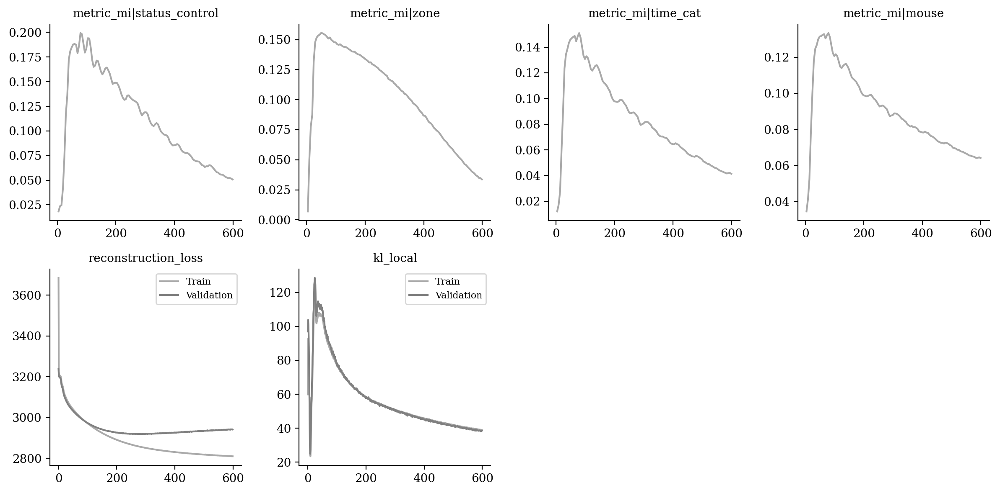

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

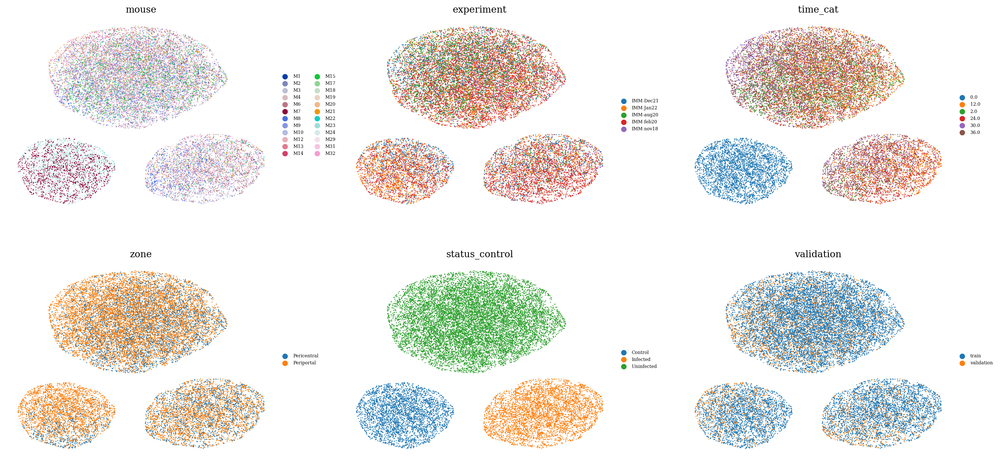

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

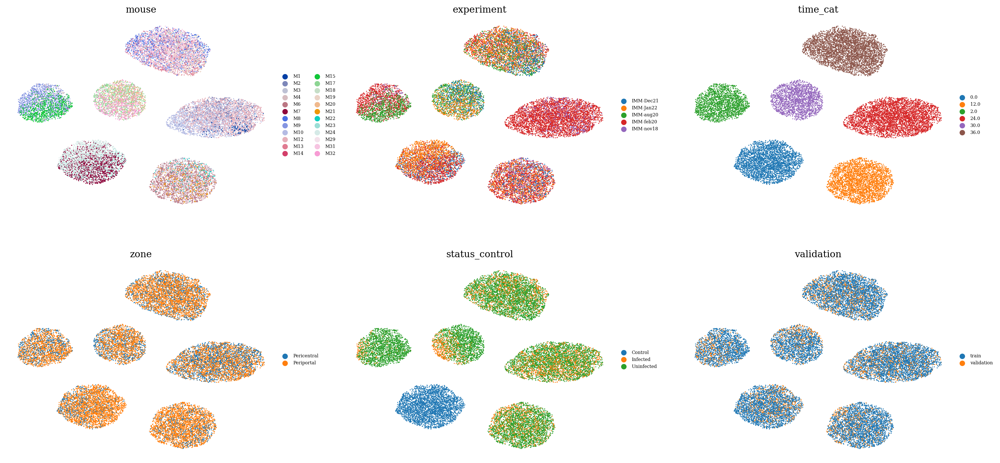

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

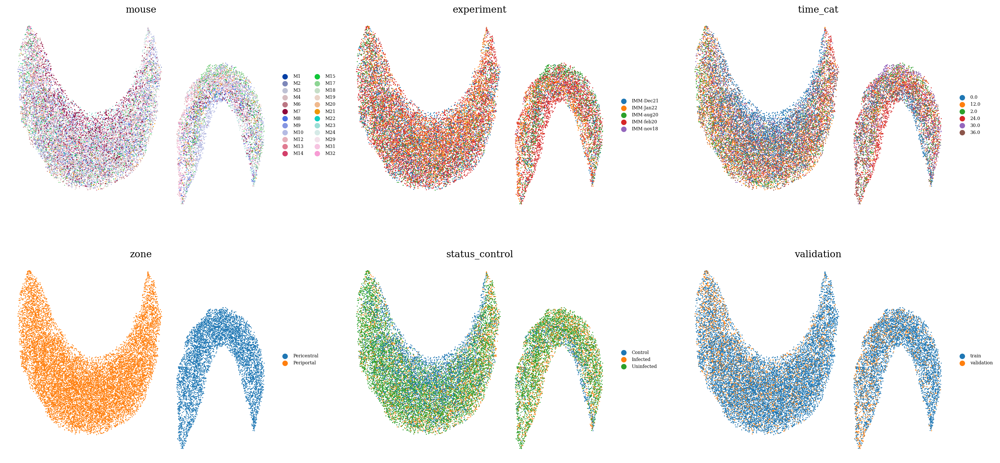

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

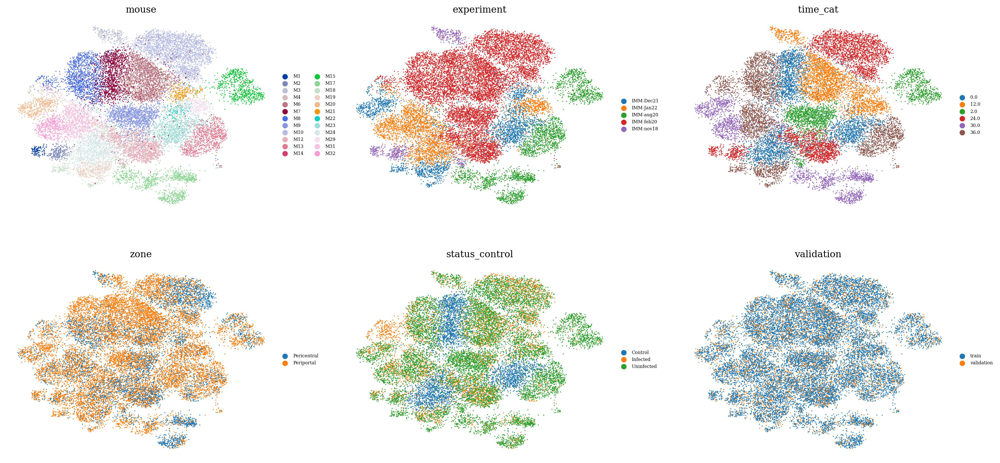

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

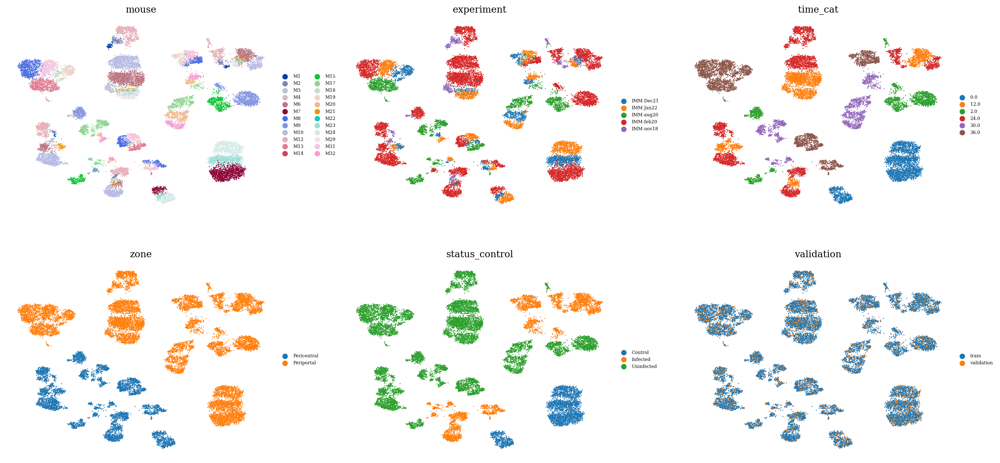

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

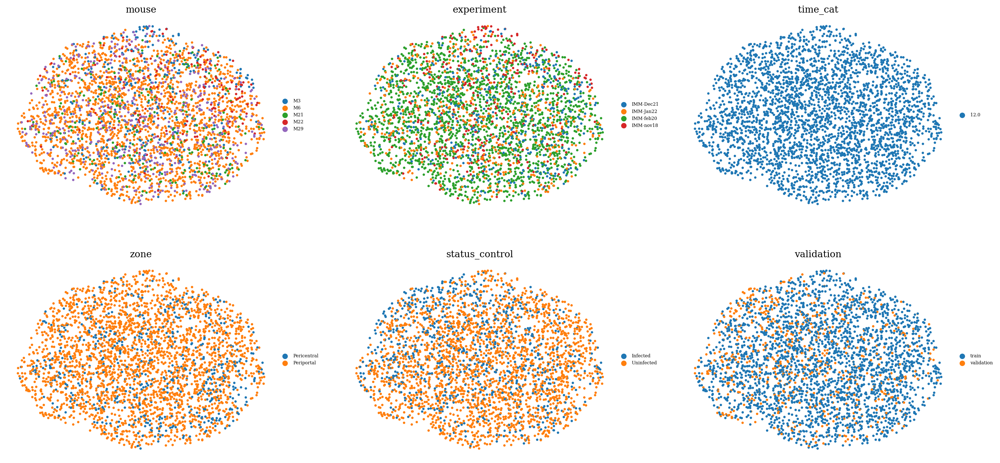

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )